
#**– Introduction –**
# Vision Zero Vehicle Crash/Colission Report
* What is the goal of your project?
* What are you investigating 
* Why is it important?

Vision Zero NYC started in the year 2014. It is a strategy to eliminate all traffic fatalities and severe injuries, while increasing safe, healthy, equitable mobility for all. First implemented in Sweden in the 1990s, Vision Zero has proved successful across Europe — and now it's gaining momentum in major American cities. 

 
 



## **– Data sources –**

  * Data Provided by Police Department (NYPD) City of New York Open Data
    * https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Person/f55k-p6yu
    The Motor Vehicle Collisions person table contains details for people involved in the crash. Each row represents a person (driver, occupant, pedestrian, bicyclist,..) involved in a crash

    The police report (MV104-AN) is required to be filled out for collisions where someone is injured or killed, or where there is at least $1000 worth of damage

      * UPDATE:
        * April 19, 2022
      * RECENT UPDATE: 
        * August 3, 2022

* INITIAL IMPORT FILE: 
    * Date range:  2012-07-01 00:00:00  -  2022-07-30 00:00:00      
      * Rows:  4,757,334
      * Columns:  21
* AFTER UPDATE: 
    * Date range:  2012-07-01 00:00:00  -  2022-08-01 00:00:00
      * Rows:  4,759,121
      * Columns:  21

## **- DF totals -**

* AFTER CLEANING: 
  * Date range:  2018-01-01 00:00:00  -  2022-08-01 00:00:00
    * Rows:  4,288,654
    * Columns:  15

* CATEGORIES:   
  * Bicyclists
  56799, 19
      * Rows:  29,681 
      * Columns:  17
  * 2018
      * Rows:  6,052
      * Columns:  17
  * 2019
      * Rows:  
      * Columns:  17
  * 2020
      * Rows:  
      * Columns:  17
  * 2021
      * Rows: 
      * Columns:  17
  * 2022-update on file
      * Rows:  
      * Columns:  17
---


##**– Methodologies –**
* Python libraries
  *   pandas - Primary data structure library
  *   numpy - Useful for scientific computing
  *   matplotlib.pyplot - Useful for plotting and graphing
  *   seaborn - Advanced plotting and graphing, built upon the matplotlib 
* data cleaning
  *   Checking for duplicates, null values, missing or corrupt data
  *   Dropping rows with missing values
  *   Decriptives/Exploring
  *   Grouping and looking at the values according top Gender and Age. 
  *   Narrowing the PERSON_TYPE to Bicycling
* transformations, etc.
  *   Attempting to correct/replace/coerrce the Age values
  *   Replacing missing values
  *   Dropping columns
  *   Creating New Date Columns
  *   Converting date and time columns to to their specified data types
  *   strftime() - datetime to string
* types of visualizations
  * plt
    * barh
    * plot.pie
  * sns
    * relplot
    * subplots
   * scatter plot
   * FacetGrid,barplot



> ***important notes:

>>  After querying when to change age from float to an integer considering this is police data:



>>>   "Working on a project to evaluate under-aged drinking (from a legal standpoint)? Then you should use the rounded down int value (eg if legal age is 16 and a person is 15.9, legally they are 15 and therefore under-aged drinking)" - https://stackoverflow.com/questions/67329095/when-should-you-convert-age-column-in-float-or-int



 >***FACTCHECK**
This is an analysis of  Bicycists involved in collisions and or crashes These incidencts are classified by date and time resulting in a Unique ID,Colission ID assigned by the NYPD (City of New Yorks Department of Motor Vehicles). 

 >Each year: list or show number of bicyclists are injured or killed, affected because of? Where they using safty equpment? FOR FUTURE ANALYSIS: *** fact check this
 Is Green Space and the Colaboration with CitiBike working? 
 How are the areas affected being addressed? Are they? Do the areas coincide with the planned expansions of CitiBike? 
 ecspecially in relation to the areas that citibike is expanding into. 
 (FUTURE CONSIDERATION: need to cross compare analysis first to other collision and crash data ['Collision ID'] to get geolocation data. Compare in relation to Vision Zeros expansion and future projections. Then compare that to the to citibike expansion data.)

 Grab contributing factors and do and analysis on those also


---





## **– Findings and conclusions –**

* What did you learn from the data? 
* Person Injury:
>>>Injured 22916
>>>Unspecified 6664
>>>Killed 101
  * The peak hours of incidents involving bicyclists are during the late after noon to early evening. These times correspond to high traffic times.
  * The warmer months are also showing that more accidents are happening between the months of May and October. 
    * June July and August holding the highest amounts of incidents.
  * Men are more involved in the reported incidents. 
  * Most victims of the incidents are fully concious and survive

* Was it what you expected?
* That this would be a long mystery of figuring out coding, ploting along with applyig statistical and analytical thinking? As far as the data. I have yet to be able to know if my expectations that the city greenzoning has had a direct affect on Crashes involving biclyists. 
* Has NYC Vision zero made an impact on the safety of NYC? Further analysis will be needed. 
* What kind of recommendations can be presented to NYC to improve the program?
Further analysis will be needed.
* What seems to be working or not working?
Further analysis will be needed.



#**Import libraries**

In [ ]:
#@title
import pandas as pd # primary data structure library
import numpy as np # useful for many scientific computing in Python
import seaborn as sns # useful for plotting and graphing, built upon the matplotlib library.
from seaborn.rcmod import axes_style
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
%matplotlib inline 


In [ ]:
#@title
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#@title
#Further consideration ['COLLISION_ID']
#vzmvcc = pd.read_csv('/content/Motor_Vehicle_Collisions_-_Crashes.csv')

missing_values = ['nan', '-']
vzmvcc = pd.read_csv('/content/drive/MyDrive/Capstone_python/csv_files/Motor_Vehicle_Collisions_Person_Update.csv', na_values = missing_values)

#Exploring -Descriptives


In [ ]:
#@title
print('Rows, Columns:', vzmvcc.shape)

Rows, Columns: (4759121, 21)


In [ ]:
#@title
vzmvcc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4759121 entries, 0 to 4759120
Data columns (total 21 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   UNIQUE_ID              int64  
 1   COLLISION_ID           int64  
 2   CRASH_DATE             object 
 3   CRASH_TIME             object 
 4   PERSON_ID              object 
 5   PERSON_TYPE            object 
 6   PERSON_INJURY          object 
 7   VEHICLE_ID             float64
 8   PERSON_AGE             float64
 9   EJECTION               object 
 10  EMOTIONAL_STATUS       object 
 11  BODILY_INJURY          object 
 12  POSITION_IN_VEHICLE    object 
 13  SAFETY_EQUIPMENT       object 
 14  PED_LOCATION           object 
 15  PED_ACTION             object 
 16  COMPLAINT              object 
 17  PED_ROLE               object 
 18  CONTRIBUTING_FACTOR_1  object 
 19  CONTRIBUTING_FACTOR_2  object 
 20  PERSON_SEX             object 
dtypes: float64(2), int64(2), object(17)
memory usage: 762.

In [ ]:
#@title
vzmvcc.head()

,UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,PERSON_ID,PERSON_TYPE,PERSON_INJURY,VEHICLE_ID,PERSON_AGE,EJECTION,...,BODILY_INJURY,POSITION_IN_VEHICLE,SAFETY_EQUIPMENT,PED_LOCATION,PED_ACTION,COMPLAINT,PED_ROLE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2,PERSON_SEX
0,10249006,4229554,10/26/2019,9:43,31aa2bc0-f545-444f-8cdb-f1cb5cf00b89,Occupant,Unspecified,19141108.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,U
1,10255054,4230587,10/25/2019,15:15,4629e500-a73e-48dc-b8fb-53124d124b80,Occupant,Unspecified,19144075.0,33.0,Not Ejected,...,Does Not Apply,"Front passenger, if two or more persons, inclu...",Lap Belt & Harness,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,F
2,10253177,4230550,10/26/2019,17:55,ae48c136-1383-45db-83f4-2a5eecfb7cff,Occupant,Unspecified,19143133.0,55.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,M
3,6650180,3565527,11/21/2016,13:05,2782525,Occupant,Unspecified,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Notified Person,NaN,NaN,NaN
4,10255516,4231168,10/25/2019,11:16,e038e18f-40fb-4471-99cf-345eae36e064,Occupant,Unspecified,19144329.0,7.0,Not Ejected,...,Does Not Apply,Right rear passenger or motorcycle sidecar pas...,Lap Belt,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,F


In [ ]:
#@title
vzmvcc.tail()

,UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,PERSON_ID,PERSON_TYPE,PERSON_INJURY,VEHICLE_ID,PERSON_AGE,EJECTION,...,BODILY_INJURY,POSITION_IN_VEHICLE,SAFETY_EQUIPMENT,PED_LOCATION,PED_ACTION,COMPLAINT,PED_ROLE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2,PERSON_SEX
4759116,12237656,4532695,05/25/2022,7:45,7fa9e3a1-3764-4120-ac08-3d55c1dc745f,Occupant,Unspecified,20228760.0,80.0,Not Ejected,...,Does Not Apply,Driver,Unknown,NaN,NaN,Does Not Apply,Driver,NaN,NaN,M
4759117,12237755,4532762,05/27/2022,21:19,7beca02f-5ee1-4522-b0fa-3db66622fc3c,Occupant,Unspecified,20228808.0,28.0,Not Ejected,...,Does Not Apply,Driver,Unknown,NaN,NaN,Does Not Apply,Driver,NaN,NaN,F
4759118,12235895,4532321,05/29/2022,16:25,c2bbb9e1-85f3-4a9b-ae19-2469c9fda817,Occupant,Unspecified,20227746.0,6.0,Not Ejected,...,Does Not Apply,"Left rear passenger, or rear passenger on a bi...",Lap Belt,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,M
4759119,12236503,4532001,05/29/2022,4:55,e19f3667-c115-44f6-a551-1357ad487eef,Occupant,Unspecified,20228100.0,20.0,Not Ejected,...,Does Not Apply,Driver,Unknown,NaN,NaN,Does Not Apply,Driver,NaN,NaN,M
4759120,12238893,4532914,05/29/2022,9:30,e41613bc-3be9-483f-8c36-844ddbc33b9a,Occupant,Injured,20229484.0,21.0,Not Ejected,...,Neck,Driver,Unknown,NaN,NaN,Whiplash,Driver,NaN,NaN,M


####Checking for null values


In [ ]:
#@title
# display counts of missing values with a summary list
vzmvcc.isnull().sum()

UNIQUE_ID                      0
COLLISION_ID                   0
CRASH_DATE                     0
CRASH_TIME                     0
PERSON_ID                     19
PERSON_TYPE                    0
PERSON_INJURY                  0
VEHICLE_ID                188613
PERSON_AGE                465768
EJECTION                 2323510
EMOTIONAL_STATUS         2259080
BODILY_INJURY            2259037
POSITION_IN_VEHICLE      2323176
SAFETY_EQUIPMENT         2330431
PED_LOCATION             4690531
PED_ACTION               4690632
COMPLAINT                2259030
PED_ROLE                  194891
CONTRIBUTING_FACTOR_1    4691795
CONTRIBUTING_FACTOR_2    4691887
PERSON_SEX                545383
dtype: int64

In [ ]:
#@title
# check missing values in different columns via heatmap
#the column of ['PED_LOCATION', 'PED_ACTION', 'CONTRIBUTING_FACTOR_1', 'CONTRIBUTING_FACTOR_2'] mostly null values - new fields? -not being implemented?
#sns.heatmap(vzmvcc.isnull(), cbar=False) 

In [ ]:
#@title
vzmvcc.dtypes

UNIQUE_ID                  int64
COLLISION_ID               int64
CRASH_DATE                object
CRASH_TIME                object
PERSON_ID                 object
PERSON_TYPE               object
PERSON_INJURY             object
VEHICLE_ID               float64
PERSON_AGE               float64
EJECTION                  object
EMOTIONAL_STATUS          object
BODILY_INJURY             object
POSITION_IN_VEHICLE       object
SAFETY_EQUIPMENT          object
PED_LOCATION              object
PED_ACTION                object
COMPLAINT                 object
PED_ROLE                  object
CONTRIBUTING_FACTOR_1     object
CONTRIBUTING_FACTOR_2     object
PERSON_SEX                object
dtype: object

## Unique 

In [ ]:
#@title
#@title
vzmvcc.columns

Index(['UNIQUE_ID', 'COLLISION_ID', 'CRASH_DATE', 'CRASH_TIME', 'PERSON_ID',
       'PERSON_TYPE', 'PERSON_INJURY', 'VEHICLE_ID', 'PERSON_AGE', 'EJECTION',
       'EMOTIONAL_STATUS', 'BODILY_INJURY', 'POSITION_IN_VEHICLE',
       'SAFETY_EQUIPMENT', 'PED_LOCATION', 'PED_ACTION', 'COMPLAINT',
       'PED_ROLE', 'CONTRIBUTING_FACTOR_1', 'CONTRIBUTING_FACTOR_2',
       'PERSON_SEX'],
      dtype='object')

In [ ]:
#@title
#@title
print(vzmvcc['PERSON_SEX'].unique())

['U' 'F' 'M' nan]


In [ ]:
#@title
#@title
print(vzmvcc['PERSON_TYPE'].unique())

['Occupant' 'Pedestrian' 'Bicyclist' 'Other Motorized']


In [ ]:
#@title
#@title
print(vzmvcc['EMOTIONAL_STATUS'].unique())

[nan 'Does Not Apply' 'Conscious' 'Unknown' 'Shock' 'Incoherent'
 'Semiconscious' 'Apparent Death' 'Unconscious']


In [ ]:
#@title
#@title
print(vzmvcc['BODILY_INJURY'].unique())

[nan 'Does Not Apply' 'Back' 'Shoulder - Upper Arm' 'Knee-Lower Leg Foot'
 'Head' 'Elbow-Lower-Arm-Hand' 'Chest' 'Neck' 'Unknown' 'Hip-Upper Leg'
 'Entire Body' 'Abdomen - Pelvis' 'Face' 'Eye']


In [ ]:
#@title
#@title
print(vzmvcc['PERSON_INJURY'].unique())

['Unspecified' 'Injured' 'Killed']


In [ ]:
#@title
#@title
print(vzmvcc['SAFETY_EQUIPMENT'].unique())

[nan 'Lap Belt & Harness' 'Lap Belt' 'Unknown' 'None' 'Other'
 'Child Restraint Only' 'Helmet Only (In-Line Skater/Bicyclist)'
 'Helmet (Motorcycle Only)' 'Air Bag Deployed/Lap Belt/Harness'
 'Air Bag Deployed' 'Air Bag Deployed/Lap Belt'
 'Helmet/Other (In-Line Skater/Bicyclist)' 'Harness'
 'Air Bag Deployed/Child Restraint'
 'Stoppers Only (In-Line Skater/Bicyclist)'
 'Pads Only (In-Line Skater/Bicyclist)' 'Lap Belt/Harness']


In [ ]:
#@title
#@title
vzmvcc.COLLISION_ID.is_unique

False

In [ ]:
#@title
#@title
#INDEX ?
vzmvcc.UNIQUE_ID.is_unique

True

##**DataFrame** - Checking for, dropping duplicates if needed

###**DataFrame** - BUFFER -Selecting or dropped columns/ rows/ changing data types

In [ ]:
#@title
#@title
# drop duplicate data 
vzvcc = vzmvcc.drop_duplicates()
vzvcc.shape == vzmvcc.shape  
# vzmvcc Rows, Columns: (4757334, 21), no duplicate rows

True

In [ ]:
#@title
#@title
vzvcc = pd.DataFrame(vzmvcc)

In [ ]:
#@title
#@title
print('Rows:, Columns:', vzvcc.shape)

Rows:, Columns: (4759121, 21)


In [ ]:
#@title
#@title
print(vzvcc['PERSON_AGE'].value_counts())

0.0       545841
29.0       96061
30.0       96023
28.0       95903
27.0       95837
           ...  
2211.0         1
793.0          1
854.0          1
2222.0         1
1991.0         1
Name: PERSON_AGE, Length: 860, dtype: int64


In [ ]:
#@title
#@title
vzvcc.PERSON_AGE.isnull().sum()

465768

###**Cleaning, Wrangling, Sorting,**

In [ ]:
#@title
#@title
vzvcc.shape

(4759121, 21)

In [ ]:
#@title
#@title
vzmvcc.columns

Index(['UNIQUE_ID', 'COLLISION_ID', 'CRASH_DATE', 'CRASH_TIME', 'PERSON_ID',
       'PERSON_TYPE', 'PERSON_INJURY', 'VEHICLE_ID', 'PERSON_AGE', 'EJECTION',
       'EMOTIONAL_STATUS', 'BODILY_INJURY', 'POSITION_IN_VEHICLE',
       'SAFETY_EQUIPMENT', 'PED_LOCATION', 'PED_ACTION', 'COMPLAINT',
       'PED_ROLE', 'CONTRIBUTING_FACTOR_1', 'CONTRIBUTING_FACTOR_2',
       'PERSON_SEX'],
      dtype='object')

####ilocate  (find use for you )

In [ ]:
#@title
#@title
vzvcc.iloc[155:160, 5:6]

,PERSON_TYPE
155,Occupant
156,Occupant
157,Occupant
158,Occupant
159,Occupant


In [ ]:
#@title
#@title
vzvcc.iloc[11:15]

,UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,PERSON_ID,PERSON_TYPE,PERSON_INJURY,VEHICLE_ID,PERSON_AGE,EJECTION,...,BODILY_INJURY,POSITION_IN_VEHICLE,SAFETY_EQUIPMENT,PED_LOCATION,PED_ACTION,COMPLAINT,PED_ROLE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2,PERSON_SEX
11,10255322,4230840,10/26/2019,23:50,a8569ace-559f-4551-8ec9-92c4c57fa7c4,Occupant,Unspecified,19144233.0,52.0,Not Ejected,...,Does Not Apply,"Front passenger, if two or more persons, inclu...",Lap Belt & Harness,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,F
12,10254506,4230701,10/24/2019,4:40,ee346dc7-1239-4abb-80c4-f971db657891,Occupant,Unspecified,19143798.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,U
13,10252623,4230916,10/24/2019,1:44,c9aed1ae-85a6-4a7e-b8d0-107efaa7d40c,Occupant,Unspecified,19142851.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,U
14,10252669,4231183,10/02/2019,21:30,f5780e46-b7e5-4c64-a955-609f721df64a,Occupant,Unspecified,19142868.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,U


#### Renaming columns for visualizations

In [ ]:
#@title
#@title
vzvcc = pd.DataFrame(vzvcc).rename(columns = {'UNIQUE_ID': 'Unique ID', 'COLLISION_ID': 'Collision ID', 'CRASH_DATE': 'Crash Date', 'CRASH_TIME': 'Crash Time', 'PERSON_ID': 'Person ID', 'PERSON_TYPE': 'Person Type', 'PERSON_INJURY': 'Person Injury', 'VEHICLE_ID': 'Vehicle ID', 'BODILY_INJURY': 'Bodily Injury', 'POSITION_IN_VEHICLE': 'Position in Vehicle', 'PERSON_AGE': 'Age', 'EJECTION': 'Ejection', 'EMOTIONAL_STATUS': 'Emotional Status', 'SAFETY_EQUIPMENT': 'Safety Equipment', 'COMPLAINT': 'Complaint', 'PED_ROLE': 'Person Role', 'PERSON_SEX': 'Gender'})

In [ ]:
#@title
#@title
vzvcc.columns

Index(['Unique ID', 'Collision ID', 'Crash Date', 'Crash Time', 'Person ID',
       'Person Type', 'Person Injury', 'Vehicle ID', 'Age', 'Ejection',
       'Emotional Status', 'Bodily Injury', 'Position in Vehicle',
       'Safety Equipment', 'PED_LOCATION', 'PED_ACTION', 'Complaint',
       'Person Role', 'CONTRIBUTING_FACTOR_1', 'CONTRIBUTING_FACTOR_2',
       'Gender'],
      dtype='object')

####Dropping columns

In [ ]:
#@title
#@title
drop_cols = ['PED_LOCATION', 'PED_ACTION', 'CONTRIBUTING_FACTOR_1', 'CONTRIBUTING_FACTOR_2', 'Person ID', 'Vehicle ID' ]
vzvcc.drop(drop_cols, inplace = True, axis=1)

In [ ]:
#@title
#@title
vzvcc.shape

(4759121, 15)

In [ ]:
#@title
#@title
vzvcc.head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender
0,10249006,4229554,10/26/2019,9:43,Occupant,Unspecified,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,U
1,10255054,4230587,10/25/2019,15:15,Occupant,Unspecified,33.0,Not Ejected,Does Not Apply,Does Not Apply,"Front passenger, if two or more persons, inclu...",Lap Belt & Harness,Does Not Apply,Passenger,F


In [ ]:
#@title
#@title
vzvcc.columns

Index(['Unique ID', 'Collision ID', 'Crash Date', 'Crash Time', 'Person Type',
       'Person Injury', 'Age', 'Ejection', 'Emotional Status', 'Bodily Injury',
       'Position in Vehicle', 'Safety Equipment', 'Complaint', 'Person Role',
       'Gender'],
      dtype='object')

####Coercing Age column ??? 

In [ ]:
#@title
#@title
print(vzvcc['Age'].value_counts())

0.0       545841
29.0       96061
30.0       96023
28.0       95903
27.0       95837
           ...  
2211.0         1
793.0          1
854.0          1
2222.0         1
1991.0         1
Name: Age, Length: 860, dtype: int64


In [ ]:
#@title
#@title
vzvcc.Age.isnull().sum()

465768

In [ ]:
#@title
#@title
vzvcc.Age = vzvcc.Age.map(lambda x: np.nan if x <0 or x >100 else x)

In [ ]:
#@title
#@title
# another way to do it: df3 = df3.dropna()
vzvcc.dropna(subset=['Age'],inplace=True)


In [ ]:
#@title
#@title
print(vzvcc['Age'].value_counts().nunique())

101


In [ ]:
#@title
#@title
vzvcc.Age.isnull().sum()

0

In [ ]:
#@title
#@title
vzvcc.dtypes
#.Age = vzvcc.Age.map(lambda x: np.nan if x <0 or x >100 else x)

Unique ID                int64
Collision ID             int64
Crash Date              object
Crash Time              object
Person Type             object
Person Injury           object
Age                    float64
Ejection                object
Emotional Status        object
Bodily Injury           object
Position in Vehicle     object
Safety Equipment        object
Complaint               object
Person Role             object
Gender                  object
dtype: object

####Converting the date and time columns to to their specified data types

In [ ]:
#@title
#@title
vzvcc['Age'] = vzvcc['Age'].astype(int)

In [ ]:
#@title
#@title
vzvcc['Crash Date'] = pd.to_datetime(vzvcc['Crash Date'])

In [ ]:
#@title
#@title
#'Reported Bicyclist Colissions or Crashes 2018-Preset'
#check min max crash dates
min_date = min(vzvcc['Crash Date'])
max_date = max(vzvcc['Crash Date'])
print('Date range: ', min_date, ' - ', max_date)

Date range:  2012-07-01 00:00:00  -  2022-08-01 00:00:00


In [ ]:
#@title
#@title
vzvcc.shape

(4288654, 15)

#Categorized

#**DataFrame** -BICYCLIST Category 07/2012-2022-update on file

##**DataFrame** 07/2012-2022-update on file

In [ ]:
#@title
vzvcbike = pd.DataFrame(vzvcc)

In [ ]:
#@title
#biclycle_a = vzvcbike[(vzvcbike['Person Type'] == '^(?!Bicyclist$).*')].index
biclycle_a = vzvcbike[(vzvcbike['Person Type'] == 'Occupant') | (vzvcbike['Person Type'] == 'Pedestrian') | (vzvcbike['Person Type'] == 'Other Motorized')].index
vzvcbike.drop(biclycle_a, inplace=True)

#### Date Time columns created

In [ ]:
#@title
vzvcbike['Year Month'] = vzvcbike['Crash Date'].map(lambda dt: dt.strftime('%Y-%m'))
vzvcbike['Month Year'] = vzvcbike['Crash Date'].map(lambda dt: dt.strftime('%m-%Y'))
vzvcbike['Crash Date Time'] = pd.to_datetime(vzvcbike['Crash Date'].map(str) +'-'+ vzvcbike['Crash Time'])
vzvcbike['Time Month Year'] =pd.to_datetime(vzvcbike['Crash Time'].map(str) +'-'+ vzvcbike['Month Year'])

In [ ]:
#@title
#vzvcbike = vzvcbike['Crash Date Time'].sort_values(ascending=False)

###Creating Index 

In [ ]:
#@title
#.index  Future analysis... ID#s shared accross all three databases.)
vzvcbike.set_index(['Unique ID']).head(2)

,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
Unique ID,,,,,,,,,,,,,,,,,,
10254556,4230715,2019-10-26,8:50,Bicyclist,Injured,42,Not Ejected,Unknown,Knee-Lower Leg Foot,Driver,Unknown,None Visible,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-08:50,2022-08-08 08:50:00-20:19
10250834,4230376,2019-10-26,19:40,Bicyclist,Injured,36,Not Ejected,Conscious,Back,Driver,None,Internal,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-19:40,2022-08-08 19:40:00-20:19


###Descriptives

In [ ]:
#@title
print('Rows:\nColumns:\n',vzvcbike.shape)

Rows:
Columns:
 (56799, 19)


In [ ]:
#@title
print('Vision Zero - Person Injury - Bicyclists info\n',vzvcbike.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 56799 entries, 18 to 4759099
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Unique ID            56799 non-null  int64         
 1   Collision ID         56799 non-null  int64         
 2   Crash Date           56799 non-null  datetime64[ns]
 3   Crash Time           56799 non-null  object        
 4   Person Type          56799 non-null  object        
 5   Person Injury        56799 non-null  object        
 6   Age                  56799 non-null  int64         
 7   Ejection             41721 non-null  object        
 8   Emotional Status     41724 non-null  object        
 9   Bodily Injury        41724 non-null  object        
 10  Position in Vehicle  41723 non-null  object        
 11  Safety Equipment     41494 non-null  object        
 12  Complaint            41724 non-null  object        
 13  Person Role          41724 n

In [ ]:
#@title
vzvcbike.head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
18,10254556,4230715,2019-10-26,8:50,Bicyclist,Injured,42,Not Ejected,Unknown,Knee-Lower Leg Foot,Driver,Unknown,None Visible,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-08:50,2022-08-08 08:50:00-20:19
31,10250834,4230376,2019-10-26,19:40,Bicyclist,Injured,36,Not Ejected,Conscious,Back,Driver,None,Internal,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-19:40,2022-08-08 19:40:00-20:19


In [ ]:
#@title
vzvcbike.tail(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
4759051,12236882,4532393,2022-05-29,18:51,Bicyclist,Unspecified,36,Not Ejected,Does Not Apply,Does Not Apply,Driver,Unknown,Does Not Apply,Driver,F,2022-05,05-2022,2022-05-29 00:00:00-18:51,2022-08-08 18:51:00-20:22
4759099,12236218,4532289,2022-05-29,9:00,Bicyclist,Injured,38,Not Ejected,Conscious,Hip-Upper Leg,Driver,Helmet Only (In-Line Skater/Bicyclist),Complaint of Pain or Nausea,Driver,M,2022-05,05-2022,2022-05-29 00:00:00-09:00,2022-08-08 09:00:00-20:22


###Column uniques

In [ ]:
#@title
#@title
print(vzvcbike['Person Type'].unique())

['Bicyclist']


In [ ]:
#@title
#@title
print(vzvcbike['Gender'].unique())

['M' 'F' nan 'U']


In [ ]:
#@title
#@title
print(vzvcbike['Person Injury'].unique())

['Injured' 'Unspecified' 'Killed']


In [ ]:
#@title
#@title
print(vzvcbike['Emotional Status'].unique())

['Unknown' 'Conscious' 'Does Not Apply' 'Shock' 'Incoherent' 'Unconscious'
 nan 'Semiconscious' 'Apparent Death']


###Value counts

In [ ]:
#@title
#Total counts of Persons Injured
print('Person Injury: \n', vzvcbike['Person Injury'].value_counts())

Person Injury: 
 Injured        47292
Unspecified     9309
Killed           198
Name: Person Injury, dtype: int64


In [ ]:
#@title
#Total counts by Gender of Persons Injured
print('Person Injury: \n', vzvcbike['Gender'].value_counts())

Person Injury: 
 M    36025
F     5611
U       88
Name: Gender, dtype: int64


In [ ]:
#@title
#Total counts by Emotional Status of Persons Injured
print('Person Injury: \n', vzvcbike['Gender'].value_counts())

Person Injury: 
 M    36025
F     5611
U       88
Name: Gender, dtype: int64


In [ ]:
#@title
vzvcbike.head()

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
18,10254556,4230715,2019-10-26,8:50,Bicyclist,Injured,42,Not Ejected,Unknown,Knee-Lower Leg Foot,Driver,Unknown,None Visible,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-08:50,2022-08-08 08:50:00-20:19
31,10250834,4230376,2019-10-26,19:40,Bicyclist,Injured,36,Not Ejected,Conscious,Back,Driver,None,Internal,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-19:40,2022-08-08 19:40:00-20:19
69,10251056,4230439,2019-10-26,0:05,Bicyclist,Injured,35,Ejected,Conscious,Elbow-Lower-Arm-Hand,Driver,None,Minor Bleeding,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-00:05,2022-08-08 00:05:00-20:19
181,10249843,4230242,2019-10-26,6:54,Bicyclist,Injured,47,Not Ejected,Conscious,Back,Driver,Helmet Only (In-Line Skater/Bicyclist),None Visible,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-06:54,2022-08-08 06:54:00-20:19
499,10254980,4230579,2019-10-25,22:24,Bicyclist,Injured,34,Ejected,Conscious,Back,Driver,Helmet Only (In-Line Skater/Bicyclist),Complaint of Pain or Nausea,Driver,M,2019-10,10-2019,2019-10-25 00:00:00-22:24,2022-08-08 22:24:00-20:19


In [ ]:
#@title
print(vzvcbike['Bodily Injury'].unique())

['Knee-Lower Leg Foot' 'Back' 'Elbow-Lower-Arm-Hand' 'Hip-Upper Leg'
 'Neck' 'Does Not Apply' 'Shoulder - Upper Arm' 'Entire Body' 'Head'
 'Face' 'Chest' 'Unknown' 'Eye' nan 'Abdomen - Pelvis']


In [ ]:
#@title
print(vzvcbike['Safety Equipment'].unique())

['Unknown' 'None' 'Helmet Only (In-Line Skater/Bicyclist)'
 'Helmet/Other (In-Line Skater/Bicyclist)' 'Other' 'Lap Belt & Harness'
 'Helmet (Motorcycle Only)' nan 'Lap Belt'
 'Stoppers Only (In-Line Skater/Bicyclist)' 'Harness'
 'Air Bag Deployed/Lap Belt' 'Pads Only (In-Line Skater/Bicyclist)'
 'Child Restraint Only' 'Air Bag Deployed/Child Restraint']


In [ ]:
#@title
#vzvcbike.set_index('Unique ID', inplace=True)
vzvcbike.sort_values(['Crash Date', 'Crash Time'], ascending=True, inplace=False).head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
600575,1885858,193861,2012-07-01,12:15,Bicyclist,Injured,21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-07,07-2012,2012-07-01 00:00:00-12:15,2022-08-08 12:15:00-20:12
2738833,1272222,9409,2012-07-01,14:14,Bicyclist,Injured,28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-07,07-2012,2012-07-01 00:00:00-14:14,2022-08-08 14:14:00-20:12


####sort_values

In [ ]:
#@title
vzvcbike.sort_values(['Crash Date', 'Crash Time'], ascending=True, inplace=False).head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year
600575,1885858,193861,2012-07-01,12:15,Bicyclist,Injured,21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-07,07-2012,2012-07-01 00:00:00-12:15,2022-08-08 12:15:00-20:12
2738833,1272222,9409,2012-07-01,14:14,Bicyclist,Injured,28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2012-07,07-2012,2012-07-01 00:00:00-14:14,2022-08-08 14:14:00-20:12


####groupby

In [ ]:
#@title
monthly2012_22 = vzvcbike['Crash Date'].dt.month.value_counts().sort_index()

In [ ]:
#@title
vzvcbike.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      17.162162
        Injured          32.411765
M       Injured          33.274463
        Unspecified      33.492953
F       Injured          33.794098
        Unspecified      33.952703
        Killed           37.545455
M       Killed           42.882353
Name: Age, dtype: float64

In [ ]:
#@title
vzvcbike.groupby(['Gender','Person Injury'])['Age'].median().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      15.0
M       Injured          30.0
U       Injured          30.0
F       Killed           30.5
        Injured          31.0
        Unspecified      31.0
M       Unspecified      31.0
        Killed           41.0
Name: Age, dtype: float64

In [ ]:
#@title
vzvcbike.groupby(['Gender','Emotional Status'])['Age'].mean().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      16.944444
        Unknown             25.800000
        Shock               30.000000
M       Unknown             31.746241
F       Apparent Death      31.818182
U       Conscious           32.818182
M       Shock               33.180511
        Conscious           33.256223
F       Shock               33.306667
M       Does Not Apply      33.510311
F       Conscious           33.746709
        Does Not Apply      34.031409
        Unknown             34.111111
        Incoherent          34.300000
M       Unconscious         35.341232
        Incoherent          35.729412
        Semiconscious       36.088146
F       Semiconscious       36.394737
U       Semiconscious       37.500000
F       Unconscious         38.483871
M       Apparent Death      41.000000
Name: Age, dtype: float64

In [ ]:
#@title
vzvcbike.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      14.0
        Unknown             24.0
F       Apparent Death      28.0
M       Unknown             29.5
        Conscious           30.0
U       Shock               30.0
        Conscious           30.5
M       Shock               30.5
        Incoherent          31.0
F       Conscious           31.0
        Does Not Apply      31.0
M       Does Not Apply      31.0
F       Unconscious         31.0
        Shock               31.0
        Semiconscious       32.5
M       Semiconscious       33.0
F       Unknown             33.0
M       Unconscious         33.0
F       Incoherent          34.0
U       Semiconscious       37.5
M       Apparent Death      38.0
Name: Age, dtype: float64

In [ ]:
#@title
vzvcbike.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      14.0
        Unknown             24.0
F       Apparent Death      28.0
M       Unknown             29.5
        Conscious           30.0
U       Shock               30.0
        Conscious           30.5
M       Shock               30.5
        Incoherent          31.0
F       Conscious           31.0
        Does Not Apply      31.0
M       Does Not Apply      31.0
F       Unconscious         31.0
        Shock               31.0
        Semiconscious       32.5
M       Semiconscious       33.0
F       Unknown             33.0
M       Unconscious         33.0
F       Incoherent          34.0
U       Semiconscious       37.5
M       Apparent Death      38.0
Name: Age, dtype: float64

In [ ]:
#@title
vzvcbike.dtypes

Unique ID                       int64
Collision ID                    int64
Crash Date             datetime64[ns]
Crash Time                     object
Person Type                    object
Person Injury                  object
Age                             int64
Ejection                       object
Emotional Status               object
Bodily Injury                  object
Position in Vehicle            object
Safety Equipment               object
Complaint                      object
Person Role                    object
Gender                         object
Year Month                     object
Month Year                     object
Crash Date Time                object
Time Month Year                object
dtype: object

##**Visualizations** 07/2012-2022-update on file


Vision Zero Bicycle Incidencts 07/2012 - 07/2022

Person Injury: 
* Injured        22916
* Unspecified     6664
* Killed           101

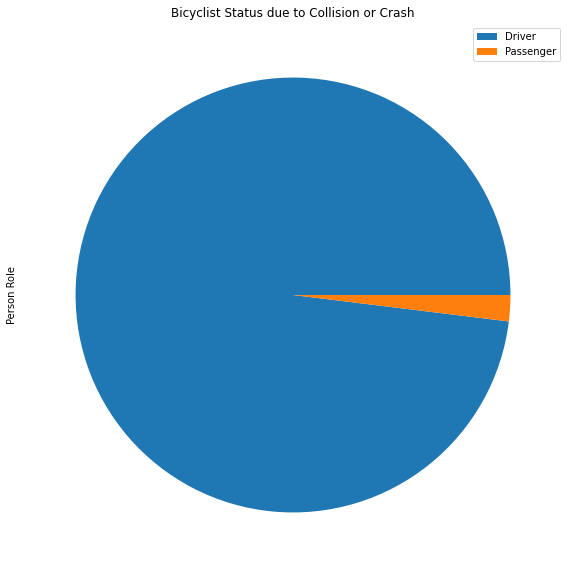

In [ ]:
#@title
vzvcbike['Person Role'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nDRIVER PASSENGER - Collision ID\n07-01-2012  -  07-31-2022')

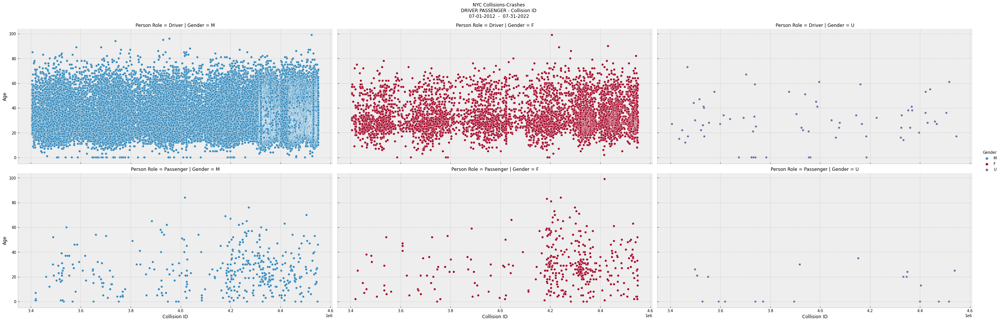

In [ ]:
#@title
gpr = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Person Role', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gpr.fig.subplots_adjust(top=0.9) # adjust the Figure in rp
gpr.fig.suptitle('NYC Collisions-Crashes\nDRIVER PASSENGER - Collision ID\n07-01-2012  -  07-31-2022')

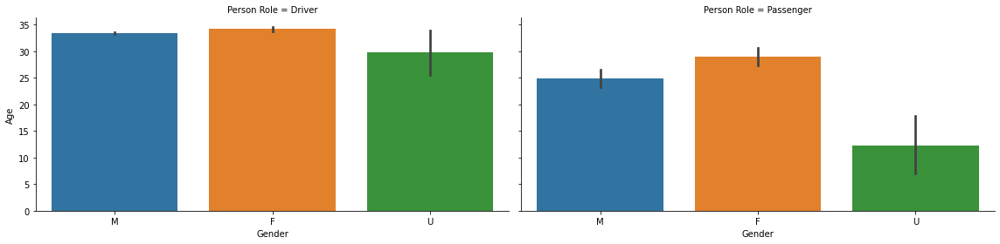

In [ ]:
#@title
vzvbi = sns.FacetGrid(data=vzvcbike, col='Person Role', hue='Gender', height=4, aspect=2, col_wrap=2)
vzvbi.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

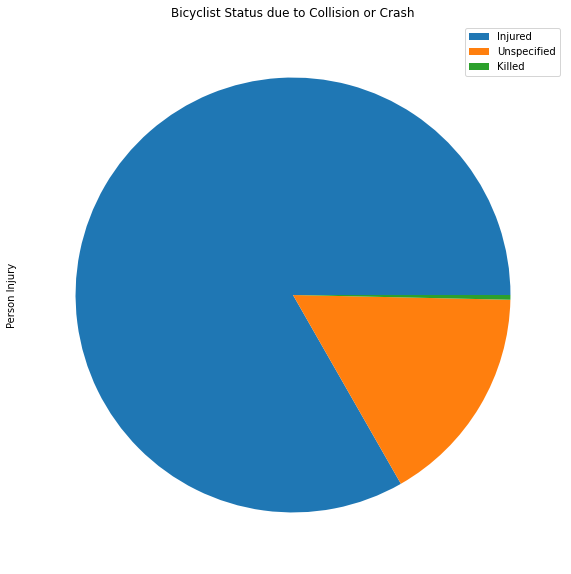

In [ ]:
#@title
vzvcbike['Person Injury'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nINJURED KILLED UNSPECIFIED - Collision ID\n07-01-2012  -  07-31-2022')

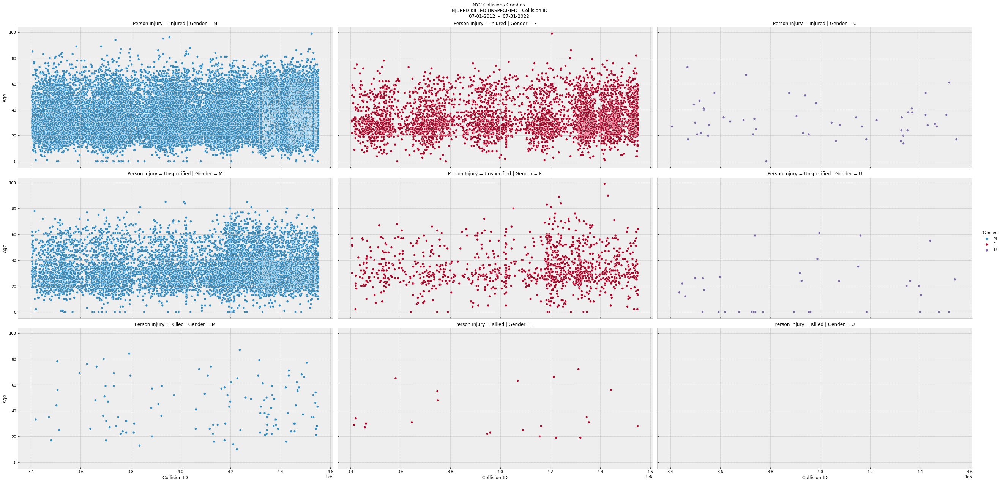

In [ ]:
#@title
gpi = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Person Injury', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gpi.fig.subplots_adjust(top=0.93) # adjust the Figure in rp
gpi.fig.suptitle('NYC Collisions-Crashes\nINJURED KILLED UNSPECIFIED - Collision ID\n07-01-2012  -  07-31-2022')

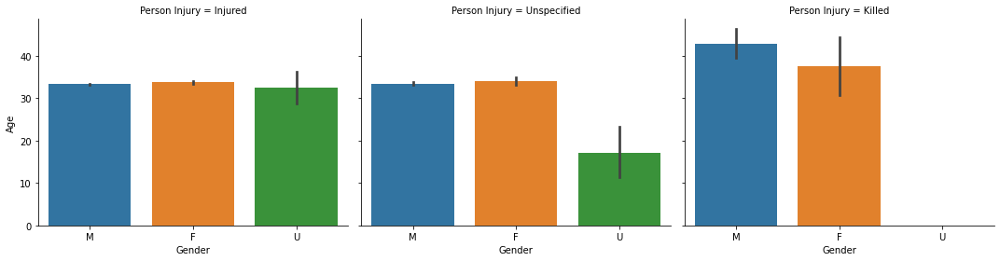

In [ ]:
#@title


vzv = sns.FacetGrid(data=vzvcbike, col='Person Injury', hue='Gender', height=4, aspect=1.25)

vzv.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])

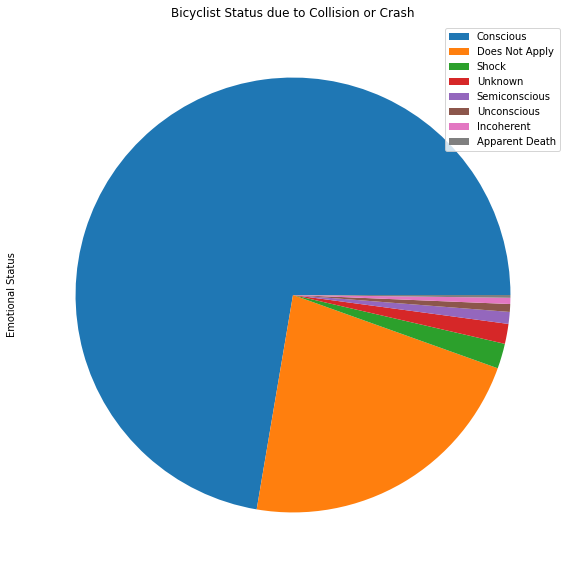

In [ ]:
#@title
vzvcbike['Emotional Status'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nEMOTIONAL STATUS - Collision ID\n07-01-2012  -  07-31-2022')

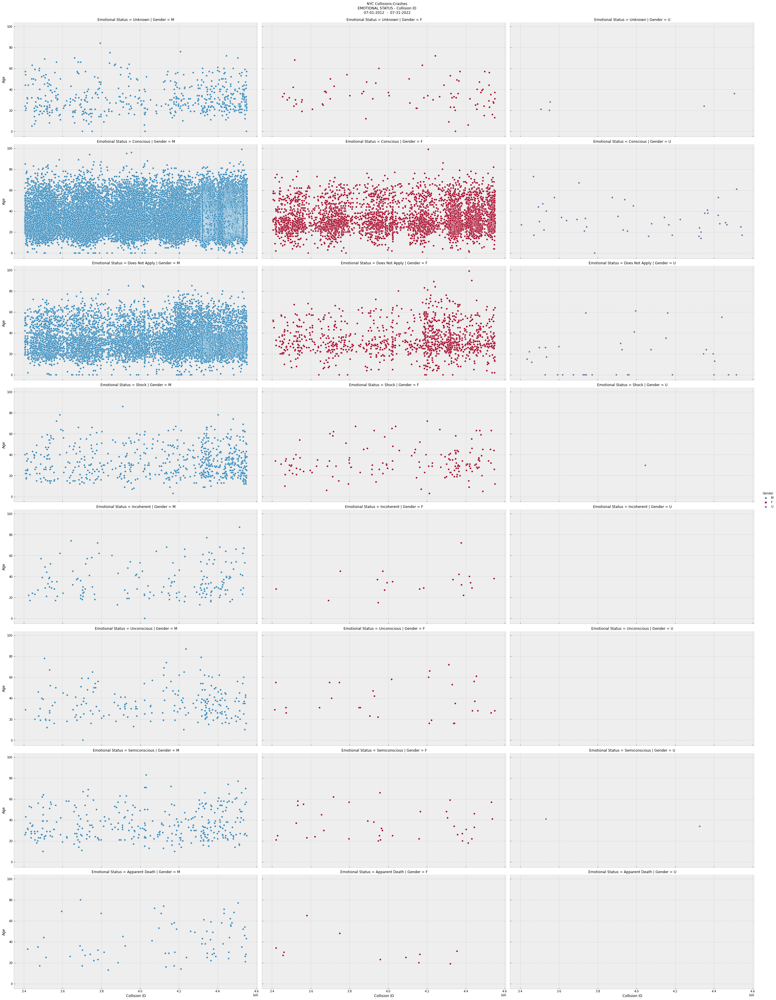

In [ ]:
#@title
gesr = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Emotional Status', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gesr.fig.subplots_adjust(top=0.96) # adjust the Figure in rp
gesr.fig.suptitle('NYC Collisions-Crashes\nEMOTIONAL STATUS - Collision ID\n07-01-2012  -  07-31-2022')

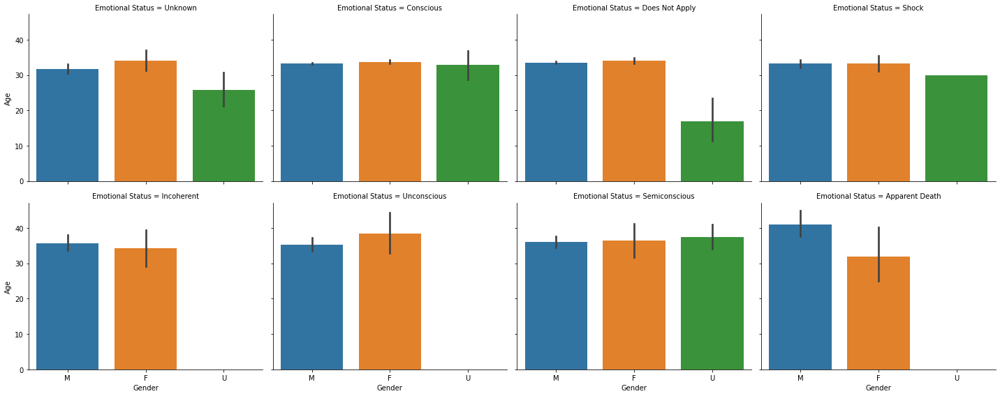

In [ ]:
#@title
\
vzvbi = sns.FacetGrid(data=vzvcbike, col='Emotional Status', hue='Gender', height=4, aspect=1.25, col_wrap=4)

vzvbi.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])




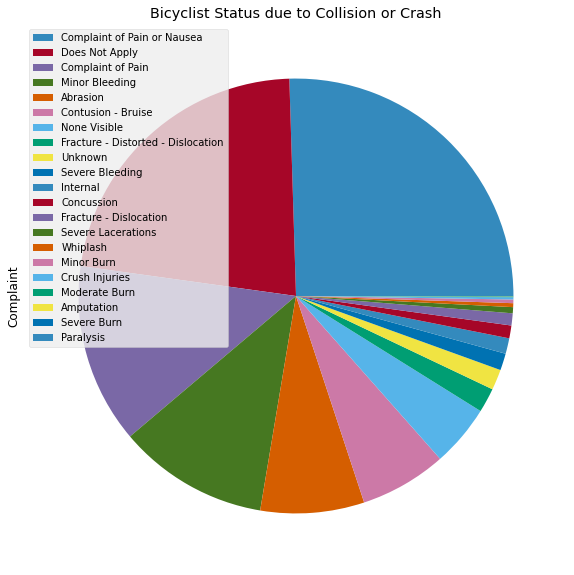

In [ ]:
#@title
vzvcbike['Complaint'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nCOMPLAINT - Collision ID\n07-01-2012  -  07-31-2022')

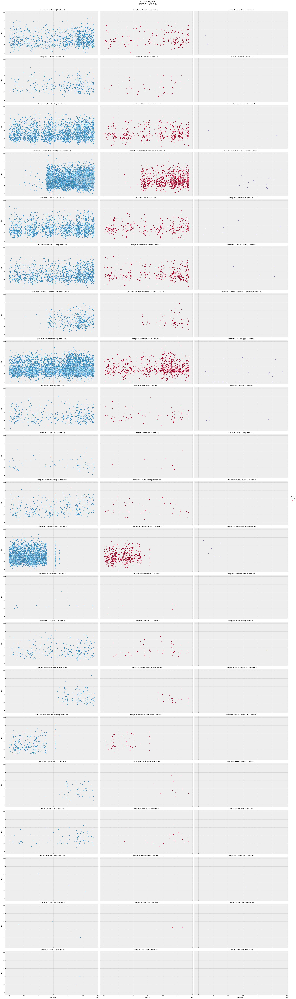

In [ ]:
#@title
gcr = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Complaint', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
gcr.fig.subplots_adjust(top=0.97)
gcr.fig.suptitle('NYC Collisions-Crashes\nCOMPLAINT - Collision ID\n07-01-2012  -  07-31-2022')

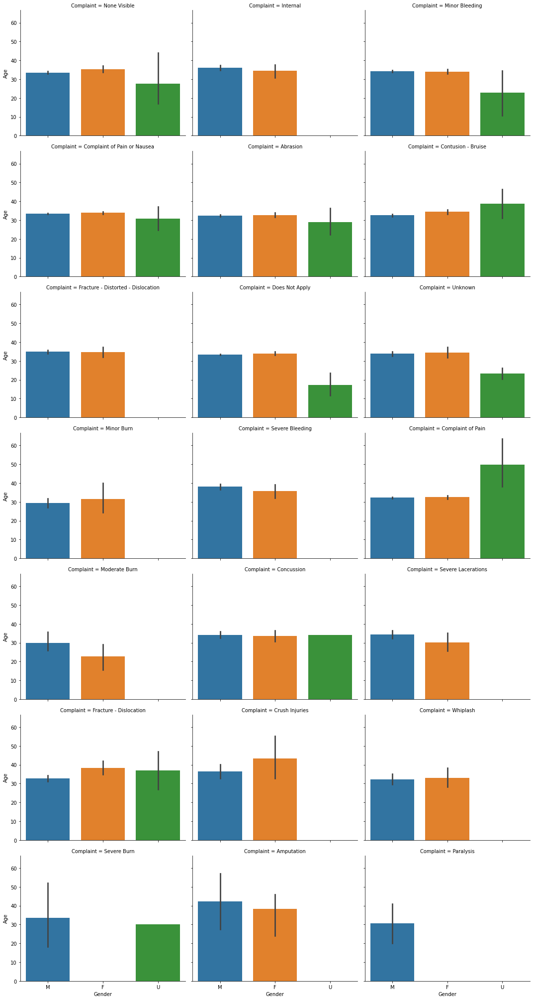

In [ ]:
#@title
vzvbi = sns.FacetGrid(data=vzvcbike, col='Complaint', hue='Gender', height=4, aspect=1.25, col_wrap=3)
vzvbi.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

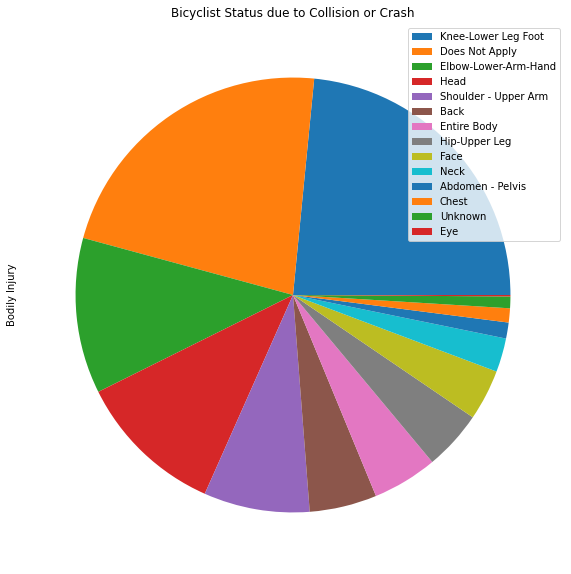

In [ ]:
#@title
vzvcbike['Bodily Injury'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nBODILY INJURY - Collision ID\n07-01-2012  -  07-31-2022')

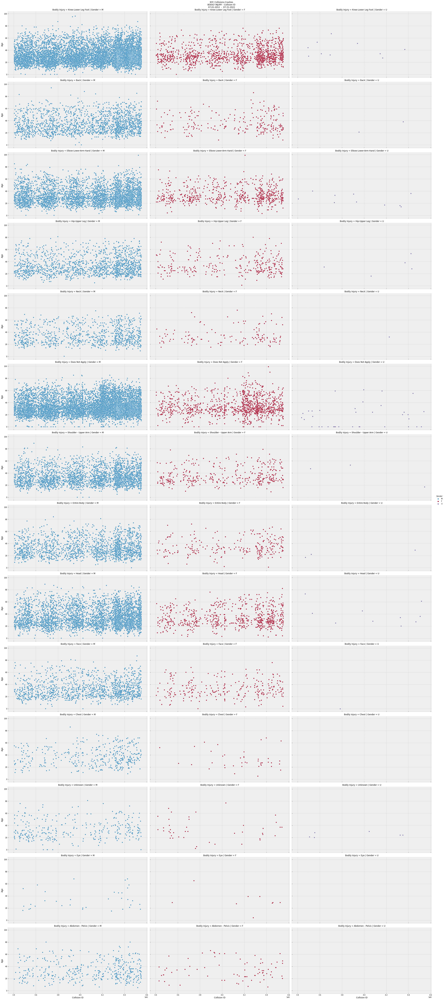

In [ ]:
#@title
gbi = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Bodily Injury', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gbi.fig.subplots_adjust(top=0.97) # adjust the Figure in rp
gbi.fig.suptitle('NYC Collisions-Crashes\nBODILY INJURY - Collision ID\n07-01-2012  -  07-31-2022')

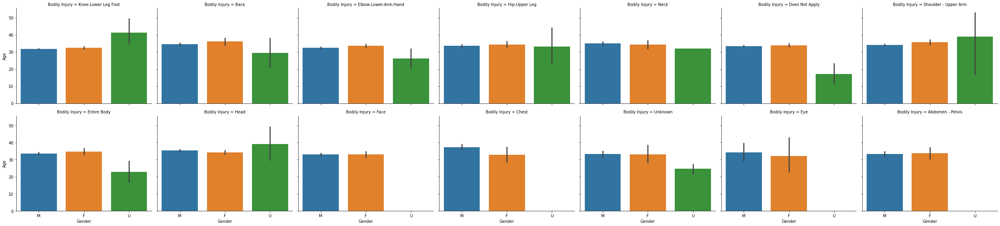

In [ ]:
#@title
vzvbi = sns.FacetGrid(data=vzvcbike, col='Bodily Injury', hue='Gender', height=4, aspect=1.25, col_wrap=7)
vzvbi.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

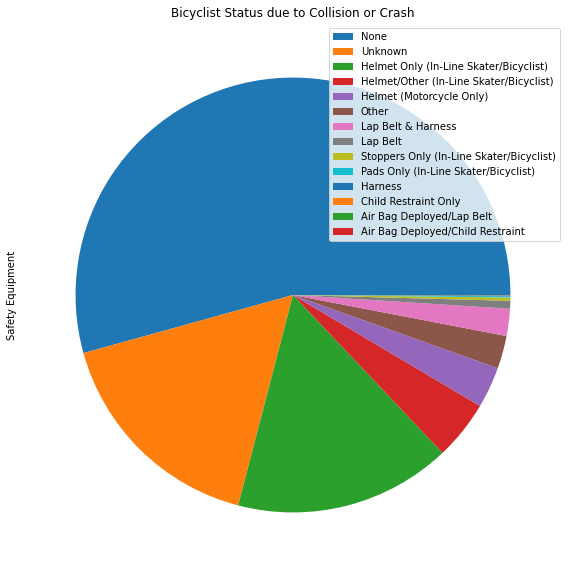

In [ ]:
#@title
vzvcbike['Safety Equipment'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nSAFETY EQUIPMENT - Collision ID\n07-01-2012  -  07-31-2022')

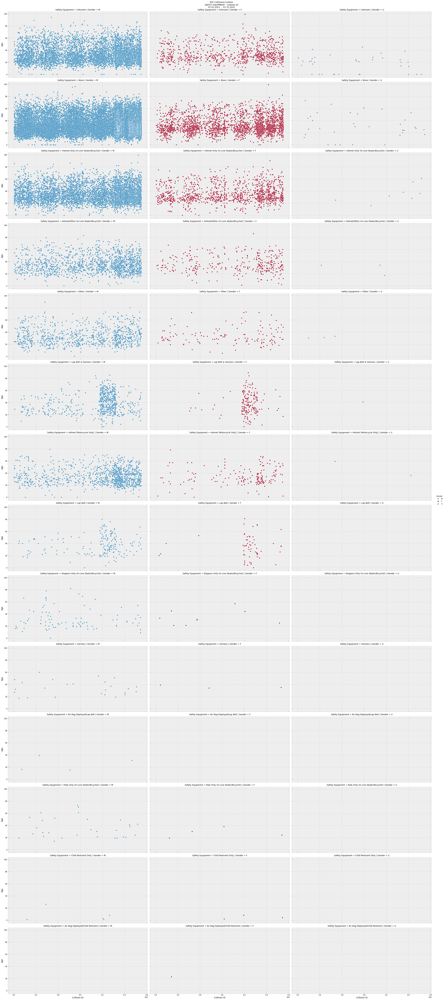

In [ ]:
#@title
gse = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Safety Equipment', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gse.fig.subplots_adjust(top=0.97) # adjust the Figure in rp
gse.fig.suptitle('NYC Collisions-Crashes\nSAFETY EQUIPMENT - Collision ID\n07-01-2012  -  07-31-2022')

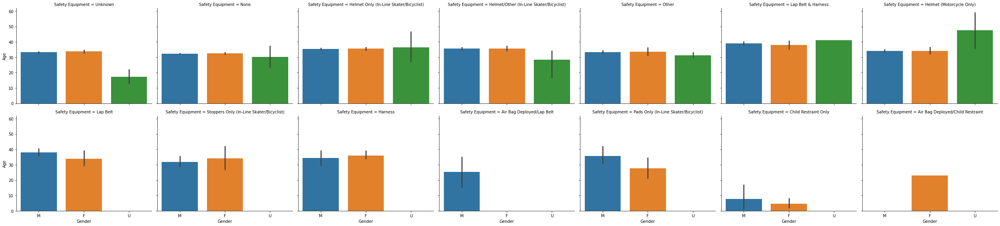

In [ ]:
#@title
vzvbi = sns.FacetGrid(data=vzvcbike, col='Safety Equipment', hue='Gender', height=4, aspect=1.25, col_wrap=7)
vzvbi.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

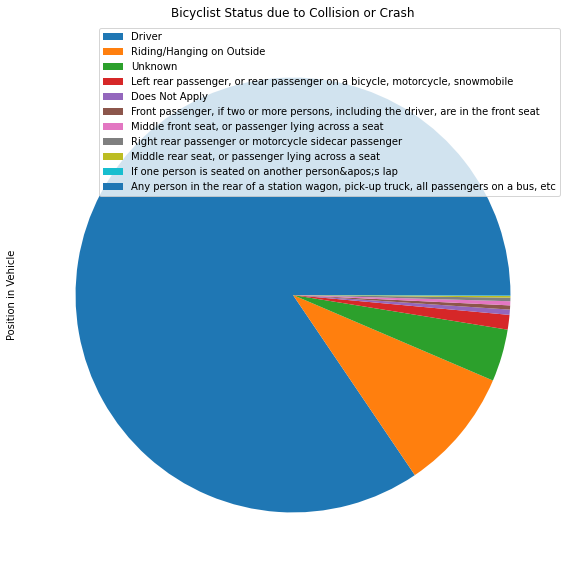

In [ ]:
#@title
vzvcbike['Position in Vehicle'].value_counts().plot.pie(figsize=(10,10), legend=True, labeldistance=None,  title='Bicyclist Status due to Collision or Crash')

Text(0.5, 0.98, 'NYC Collisions-Crashes\nPOSITION IN VEHICLE - Collision ID\n07-01-2012  -  07-31-2022')

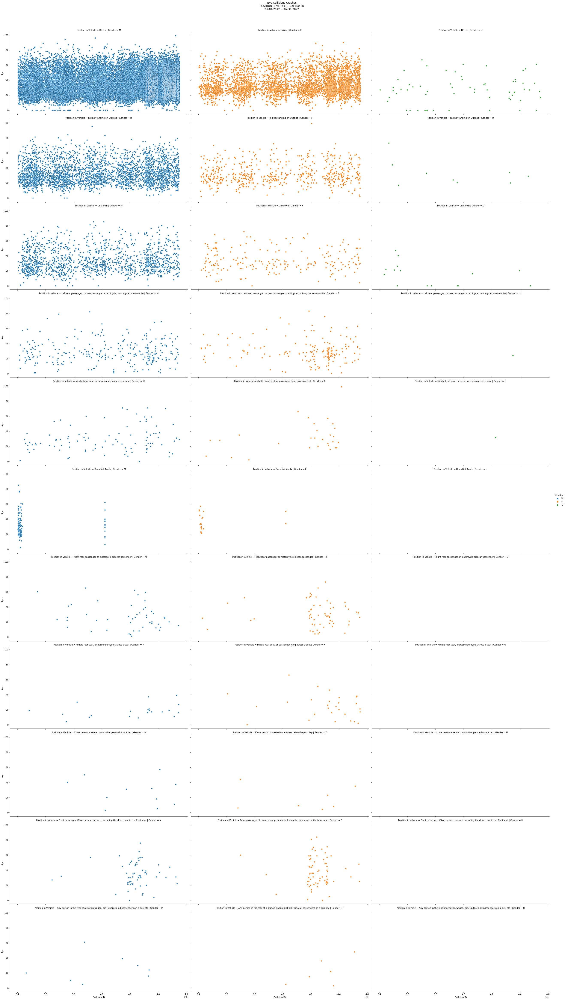

In [ ]:
#@title
gpv = sns.relplot(data=vzvcbike, x='Collision ID', y='Age',col='Gender', row='Position in Vehicle', hue='Gender',kind='scatter', legend='auto', height=6, aspect=2)
# rp is a FacetGrid; 
# relplot is a nice organized way to use it
gpv.fig.subplots_adjust(top=0.97) # adjust the Figure in rp
gpv.fig.suptitle('NYC Collisions-Crashes\nPOSITION IN VEHICLE - Collision ID\n07-01-2012  -  07-31-2022')

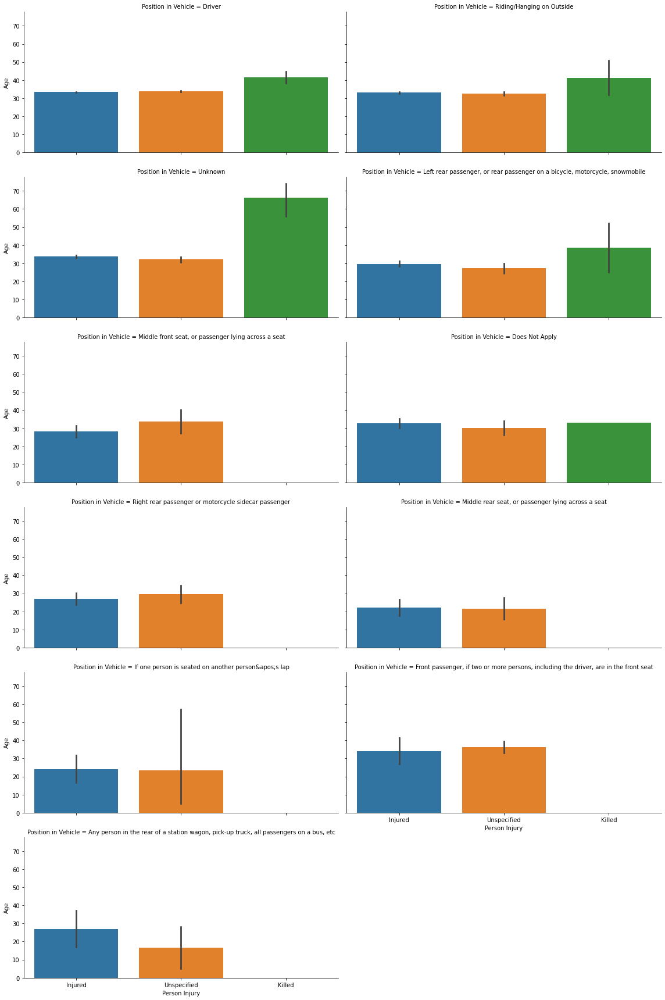

In [ ]:
#@title
vzvbi = sns.FacetGrid(data=vzvcbike, col='Position in Vehicle', hue='Person Injury', height=4, aspect=2, col_wrap=2)
vzvbi.map(sns.barplot, 'Person Injury', 'Age', order=['Injured', 'Unspecified', 'Killed'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

In [ ]:
#@title
#vzvcbike.plot.bar('Crash Date', 'Age')

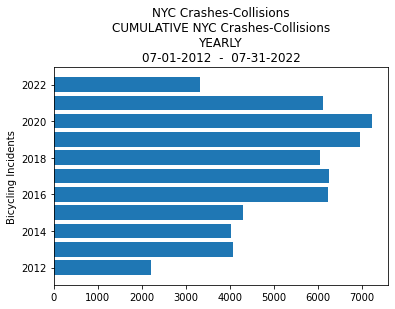

In [ ]:
#@title
yearly2012_22 = vzvcbike['Crash Date'].dt.year.value_counts().sort_index()
plt.barh(yearly2012_22.index, yearly2012_22.values)
plt.ylabel('Bicycling Incidents')
plt.title('NYC Crashes-Collisions\nCUMULATIVE NYC Crashes-Collisions\nYEARLY\n07-01-2012  -  07-31-2022')
plt.style.use(style='bmh')
plt.show()

In [ ]:
#@title
print('Crash Date by Year total counts\n',vzvcbike['Crash Date'].dt.year.value_counts().sort_index())

Crash Date by Year total counts
 2012    2217
2013    4086
2014    4020
2015    4296
2016    6239
2017    6260
2018    6052
2019    6951
2020    7242
2021    6110
2022    3326
Name: Crash Date, dtype: int64


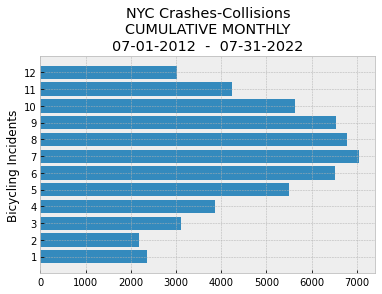

In [ ]:
#@title
monthly2012_22 = vzvcbike['Crash Date'].dt.month.value_counts().sort_index()
plt.barh(monthly2012_22.index,monthly2012_22.values)
plt.yticks(range(1,13))
plt.xlabel('')
plt.ylabel('Bicycling Incidents')
plt.title('NYC Crashes-Collisions\nCUMULATIVE MONTHLY\n07-01-2012  -  07-31-2022')
plt.style.use(style='bmh')
plt.show()

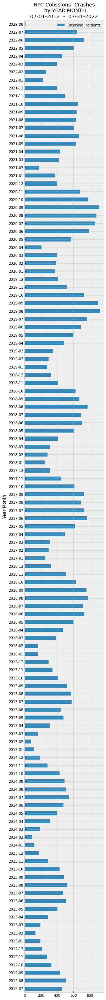

In [ ]:
#@title
#representation of the month grouped by year with strfmt
grouped_vzvcbike = vzvcbike.groupby('Year Month').size().to_frame("Bicycling Incidents").reset_index()
grouped_vzvcbike.plot(kind='barh', x='Year Month', y='Bicycling Incidents', figsize=(4,50), title='NYC Colissions- Crashes\n by YEAR MONTH\n07-01-2012  -  07-31-2022')
plt.style.use(style='bmh')
#sns.lmplot(data=vzvcbike, x='Collision ID', y='Crash Time', col='Person Injury', hue='Gender')

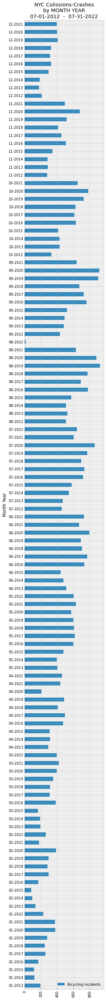

In [ ]:
#@title
#vzvcbike['Month Year'] = vzvcbike['Crash Date'].map(lambda dt: dt.strftime('%m-%Y'))
#vzvcbike['Month Year'].sort_values(ascending=True)
grouped_vzvcbike = vzvcbike.groupby('Month Year').size().to_frame("Bicycling Incidents").reset_index()
grouped_vzvcbike.plot(kind='barh', x='Month Year', y='Bicycling Incidents', figsize=(4,50),title='NYC Colissions-Crashes\nby MONTH YEAR\n07-01-2012  -  07-31-2022')
plt.xticks(rotation=90)
plt.style.use(style='bmh')

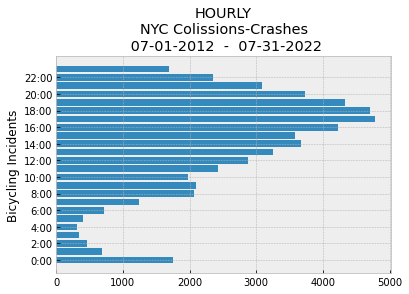

In [ ]:
#@title
hourly2012_22 = vzvcbike['Crash Time'].str.split(':').str[0].astype('int').value_counts().sort_index()
plt.barh(hourly2012_22.index,hourly2012_22.values)
plt.yticks(range(0,24,2),[str(x)+":00" for x in range(0,24,2)])
plt.xlabel('')
plt.ylabel('Bicycling Incidents')
plt.title('HOURLY\nNYC Colissions-Crashes\n 07-01-2012  -  07-31-2022')
plt.style.use(style='bmh')
plt.show()


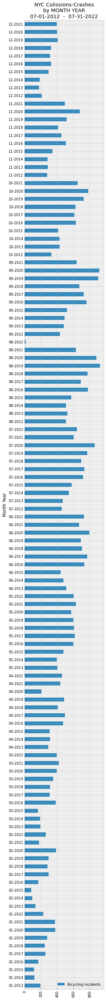

In [ ]:
#@title
vzvcbike['Crash Year Time'] = vzvcbike['Crash Date'].map(lambda dt: dt.strftime('%m-%Y'))
#vzvcbike['Month Year'].sort_values(ascending=True)
grouped_vzvcbike = vzvcbike.groupby('Month Year').size().to_frame("Bicycling Incidents").reset_index()
grouped_vzvcbike.plot(kind='barh', x='Month Year', y='Bicycling Incidents', figsize=(4,50),title='NYC Colissions-Crashes\nby MONTH YEAR\n07-01-2012  -  07-31-2022')
plt.xticks(rotation=90)
plt.style.use(style='bmh')

##**DataFrame** 01/2018-2022-update on file

In [ ]:
#@title
#@title
vzvcbike18p = pd.DataFrame(vzvcbike)

In [ ]:
#@title
#@title
date_biclycle = vzvcbike18p[(vzvcbike18p['Crash Date'] < '2018-01-01')].index
vzvcbike18p.drop(date_biclycle, inplace=True)

In [ ]:
#@title
#@title
vzvcbike18p.shape

(29681, 20)

In [ ]:
#@title
#@title
vzvcbike18p.head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year,Crash Year Time
18,10254556,4230715,2019-10-26,8:50,Bicyclist,Injured,42,Not Ejected,Unknown,Knee-Lower Leg Foot,Driver,Unknown,None Visible,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-08:50,2022-08-07 08:50:00-20:19,10-2019
31,10250834,4230376,2019-10-26,19:40,Bicyclist,Injured,36,Not Ejected,Conscious,Back,Driver,None,Internal,Driver,M,2019-10,10-2019,2019-10-26 00:00:00-19:40,2022-08-07 19:40:00-20:19,10-2019


###Column uniques

In [ ]:
#@title
#@title
print(vzvcbike18p['Gender'].unique())

['M' 'F' 'U']


In [ ]:
#@title
#@title
print(vzvcbike18p['Person Type'].unique())

['Bicyclist']


In [ ]:
#@title
#@title
print(vzvcbike18p['Emotional Status'].unique())

['Unknown' 'Conscious' 'Does Not Apply' 'Shock' 'Incoherent' 'Unconscious'
 'Semiconscious' 'Apparent Death']


In [ ]:
#@title
#@title
print(vzvcbike18p['Bodily Injury'].unique())

['Knee-Lower Leg Foot' 'Back' 'Elbow-Lower-Arm-Hand' 'Hip-Upper Leg'
 'Neck' 'Does Not Apply' 'Shoulder - Upper Arm' 'Entire Body' 'Head'
 'Face' 'Chest' 'Unknown' 'Eye' 'Abdomen - Pelvis']


In [ ]:
#@title
#@title
print(vzvcbike18p['Person Injury'].unique())

['Injured' 'Unspecified' 'Killed']


In [ ]:
#@title
#@title
print(vzvcbike18p['Safety Equipment'].unique())

['Unknown' 'None' 'Helmet Only (In-Line Skater/Bicyclist)'
 'Helmet/Other (In-Line Skater/Bicyclist)' 'Other' 'Lap Belt & Harness'
 'Helmet (Motorcycle Only)' 'Lap Belt'
 'Stoppers Only (In-Line Skater/Bicyclist)' 'Air Bag Deployed/Lap Belt'
 'Pads Only (In-Line Skater/Bicyclist)' 'Harness' 'Child Restraint Only']


In [ ]:
#@title
#@title
#Total counts of Persons Injured
print('Person Injury: \n', vzvcbike18p['Person Injury'].value_counts())

Person Injury: 
 Injured        22916
Unspecified     6664
Killed           101
Name: Person Injury, dtype: int64


In [ ]:
#@title
#@title
#Total counts by Gender of Persons Injured
print('Person Injury: \n', vzvcbike18p['Gender'].value_counts())

Person Injury: 
 M    25630
F     4001
U       50
Name: Gender, dtype: int64


In [ ]:
#@title
#@title
#Total counts by Emotional Status of Persons Injured
print('Person Injury: \n', vzvcbike18p['Gender'].value_counts())

Person Injury: 
 M    25630
F     4001
U       50
Name: Gender, dtype: int64


In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      21.550000
        Injured          31.566667
M       Injured          33.707338
        Unspecified      34.048938
F       Injured          34.191896
        Unspecified      34.395787
        Killed           36.214286
M       Killed           42.264368
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Person Injury'])['Age'].median().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      22.0
F       Killed           28.0
U       Injured          29.5
F       Injured          31.0
        Unspecified      31.0
M       Injured          31.0
        Unspecified      31.0
        Killed           42.0
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].mean().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      21.368421
F       Apparent Death      24.333333
U       Shock               30.000000
        Unknown             30.000000
        Conscious           31.407407
M       Unknown             32.511429
        Shock               33.143763
        Conscious           33.690637
U       Semiconscious       34.000000
F       Shock               34.018519
M       Does Not Apply      34.039659
F       Conscious           34.162417
        Unknown             34.315789
        Does Not Apply      34.462389
        Incoherent          35.062500
        Semiconscious       35.208333
M       Unconscious         35.454545
        Incoherent          36.593220
        Semiconscious       36.750000
F       Unconscious         37.869565
M       Apparent Death      42.666667
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      20.0
F       Apparent Death      24.0
U       Conscious           28.0
M       Unknown             30.0
U       Shock               30.0
        Unknown             30.0
F       Unconscious         31.0
M       Conscious           31.0
        Shock               31.0
F       Does Not Apply      31.0
        Conscious           31.0
        Shock               31.0
M       Does Not Apply      31.0
F       Semiconscious       32.5
M       Incoherent          32.5
F       Unknown             33.0
M       Unconscious         33.5
        Semiconscious       34.0
F       Incoherent          34.0
U       Semiconscious       34.0
M       Apparent Death      43.0
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      20.0
F       Apparent Death      24.0
U       Conscious           28.0
M       Unknown             30.0
U       Shock               30.0
        Unknown             30.0
F       Unconscious         31.0
M       Conscious           31.0
        Shock               31.0
F       Does Not Apply      31.0
        Conscious           31.0
        Shock               31.0
M       Does Not Apply      31.0
F       Semiconscious       32.5
M       Incoherent          32.5
F       Unknown             33.0
M       Unconscious         33.5
        Semiconscious       34.0
F       Incoherent          34.0
U       Semiconscious       34.0
M       Apparent Death      43.0
Name: Age, dtype: float64

###sort_values

In [ ]:
#@title
#@title
#vzvcbike18p.set_index('Unique ID', inplace=True)
vzvcbike18p.sort_values(['Crash Date', 'Crash Time'], ascending=True, inplace=False).head(2)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year,Crash Year Time
2929007,7286421,3820945,2018-01-01,0:00,Bicyclist,Injured,23,Not Ejected,Conscious,Back,Riding/Hanging on Outside,None,Complaint of Pain,Driver,M,2018-01,01-2018,2018-01-01 00:00:00+00:00,2022-08-07 00:00:00-20:18,01-2018
2241316,7279529,3821691,2018-01-01,17:50,Bicyclist,Injured,16,Ejected,Conscious,Head,Driver,None,Contusion - Bruise,Driver,M,2018-01,01-2018,2018-01-01 00:00:00-17:50,2022-08-07 17:50:00-20:18,01-2018


##**Visualizations** 2018-2022


###- Vision Zero Bicycle Incidencts 01/2018 - 07/2022

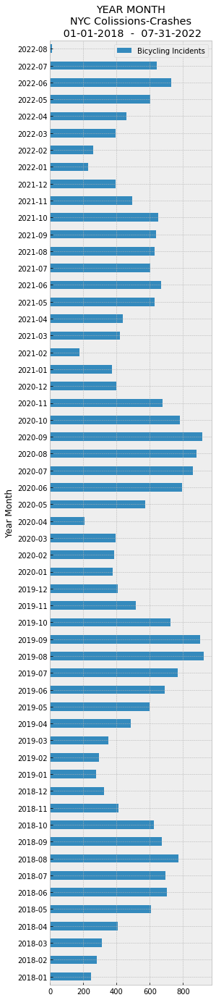

In [ ]:
#@title
#@title

# create a representation of the month with strfmt
vzvcbike18p['Year Month'] = vzvcbike18p['Crash Date'].map(lambda dt: dt.strftime('%Y-%m'))
grouped_vzvcbike18p = vzvcbike18p.groupby('Year Month').size().to_frame("Bicycling Incidents").reset_index()
grouped_vzvcbike18p.plot(kind='barh', x='Year Month', y='Bicycling Incidents', figsize=(4,24),title='YEAR MONTH\nNYC Colissions-Crashes\n 01-01-2018  -  07-31-2022')
plt.style.use(style='bmh')
#sns.lmplot(data=vzvcbike18p, x='Collision ID', y='Crash Time', col='Person Injury', hue='Gender')
#grouped_vzvcbike18p.set_xticklabels(grouped_vzvcbike18p.get_xticklabels(),rotation = 30)


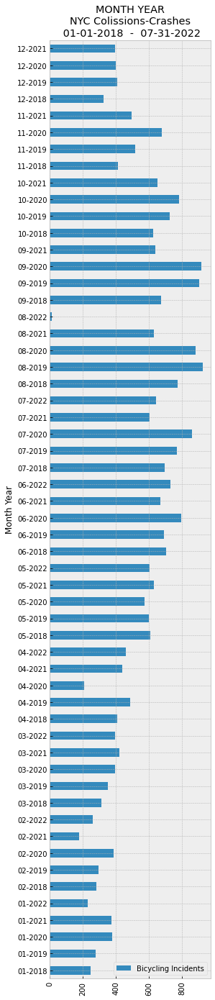

In [ ]:
#@title
#@title
vzvcbike18p['Month Year'] = vzvcbike18p['Crash Date'].map(lambda dt: dt.strftime('%m-%Y'))
grouped_vzvcbike18p = vzvcbike18p.groupby('Month Year').size().to_frame("Bicycling Incidents").reset_index()
grouped_vzvcbike18p.plot(kind='barh', x='Month Year', y='Bicycling Incidents', figsize=(4,24),title='MONTH YEAR\nNYC Colissions-Crashes\n 01-01-2018  -  07-31-2022')
plt.xticks(rotation=90)
plt.style.use(style='bmh')


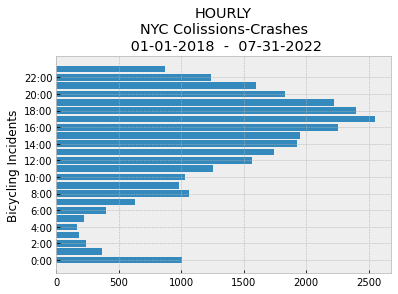

In [ ]:
#@title
#@title
hourly2018_22 = vzvcbike18p['Crash Time'].str.split(':').str[0].astype('int').value_counts().sort_index()
plt.barh(hourly2018_22.index,hourly2018_22.values)
plt.yticks(range(0,24,2),[str(x)+":00" for x in range(0,24,2)])
plt.xlabel('')
plt.ylabel('Bicycling Incidents')
plt.title('HOURLY\nNYC Colissions-Crashes\n 01-01-2018  -  07-31-2022')
plt.style.use(style='bmh')
plt.show()

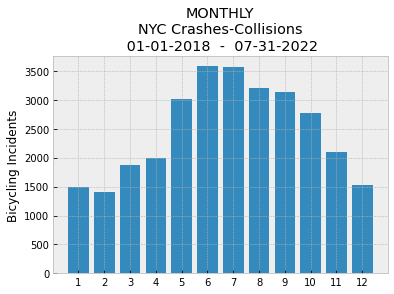

In [ ]:
#@title
#@title
monthy2018_22 = vzvcbike18p['Crash Date'].dt.month.value_counts().sort_index()
plt.bar(monthy2018_22.index,monthy2018_22.values)
plt.xticks(range(1,13))
plt.xlabel('')
plt.ylabel('Bicycling Incidents')
plt.title('MONTHLY\nNYC Crashes-Collisions\n 01-01-2018  -  07-31-2022')
plt.style.use(style='bmh')
plt.show()
#2018 Higher crashes during the warmer months..increased usage of bikes - large touristic, schools out, additional drivers, additional bike share users. 

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      21.550000
        Injured          31.566667
M       Injured          33.707338
        Unspecified      34.048938
F       Injured          34.191896
        Unspecified      34.395787
        Killed           36.214286
M       Killed           42.264368
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Person Injury'])['Age'].median().sort_values(ascending=True)

Gender  Person Injury
U       Unspecified      22.0
F       Killed           28.0
U       Injured          29.5
F       Injured          31.0
        Unspecified      31.0
M       Injured          31.0
        Unspecified      31.0
        Killed           42.0
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].mean().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      21.368421
F       Apparent Death      24.333333
U       Shock               30.000000
        Unknown             30.000000
        Conscious           31.407407
M       Unknown             32.511429
        Shock               33.143763
        Conscious           33.690637
U       Semiconscious       34.000000
F       Shock               34.018519
M       Does Not Apply      34.039659
F       Conscious           34.162417
        Unknown             34.315789
        Does Not Apply      34.462389
        Incoherent          35.062500
        Semiconscious       35.208333
M       Unconscious         35.454545
        Incoherent          36.593220
        Semiconscious       36.750000
F       Unconscious         37.869565
M       Apparent Death      42.666667
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      20.0
F       Apparent Death      24.0
U       Conscious           28.0
M       Unknown             30.0
U       Shock               30.0
        Unknown             30.0
F       Unconscious         31.0
M       Conscious           31.0
        Shock               31.0
F       Does Not Apply      31.0
        Conscious           31.0
        Shock               31.0
M       Does Not Apply      31.0
F       Semiconscious       32.5
M       Incoherent          32.5
F       Unknown             33.0
M       Unconscious         33.5
        Semiconscious       34.0
F       Incoherent          34.0
U       Semiconscious       34.0
M       Apparent Death      43.0
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.groupby(['Gender','Emotional Status'])['Age'].median().sort_values(ascending=True)

Gender  Emotional Status
U       Does Not Apply      20.0
F       Apparent Death      24.0
U       Conscious           28.0
M       Unknown             30.0
U       Shock               30.0
        Unknown             30.0
F       Unconscious         31.0
M       Conscious           31.0
        Shock               31.0
F       Does Not Apply      31.0
        Conscious           31.0
        Shock               31.0
M       Does Not Apply      31.0
F       Semiconscious       32.5
M       Incoherent          32.5
F       Unknown             33.0
M       Unconscious         33.5
        Semiconscious       34.0
F       Incoherent          34.0
U       Semiconscious       34.0
M       Apparent Death      43.0
Name: Age, dtype: float64

In [ ]:
#@title
#@title
vzvcbike18p.sort_values(['Crash Date', 'Crash Time'], ascending=True, inplace=False).head(1)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year,Crash Year Time
2929007,7286421,3820945,2018-01-01,0:00,Bicyclist,Injured,23,Not Ejected,Conscious,Back,Riding/Hanging on Outside,None,Complaint of Pain,Driver,M,2018-01,01-2018,2018-01-01 00:00:00+00:00,2022-08-07 00:00:00-20:18,01-2018


In [ ]:
#@title
#@title
vzvcbike18p.sort_values(['Crash Date', 'Crash Time'], ascending=True, inplace=False).tail(1)

,Unique ID,Collision ID,Crash Date,Crash Time,Person Type,Person Injury,Age,Ejection,Emotional Status,Bodily Injury,Position in Vehicle,Safety Equipment,Complaint,Person Role,Gender,Year Month,Month Year,Crash Date Time,Time Month Year,Crash Year Time
4296919,12312134,4552074,2022-08-01,21:37,Bicyclist,Injured,32,Ejected,Conscious,Elbow-Lower-Arm-Hand,Driver,None,Complaint of Pain or Nausea,Driver,M,2022-08,08-2022,2022-08-01 00:00:00-21:37,2022-08-07 21:37:00-20:22,08-2022


In [ ]:
#@title
#@title
print('Rows: \n', 'Columns: \n', vzvcbike18p.shape)

Rows: 
 Columns: 
 (29681, 20)


In [ ]:
#@title
#@title
vzvcbike18p.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29681 entries, 18 to 4759099
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Unique ID            29681 non-null  int64         
 1   Collision ID         29681 non-null  int64         
 2   Crash Date           29681 non-null  datetime64[ns]
 3   Crash Time           29681 non-null  object        
 4   Person Type          29681 non-null  object        
 5   Person Injury        29681 non-null  object        
 6   Age                  29681 non-null  int64         
 7   Ejection             29681 non-null  object        
 8   Emotional Status     29681 non-null  object        
 9   Bodily Injury        29681 non-null  object        
 10  Position in Vehicle  29681 non-null  object        
 11  Safety Equipment     29681 non-null  object        
 12  Complaint            29681 non-null  object        
 13  Person Role          29681 n

In [ ]:
#@title
#@title
#Total counts by Emotional Status of Persons Injured
print('Person Injury: \n', vzvcbike18p['Gender'].value_counts())

Person Injury: 
 M    25630
F     4001
U       50
Name: Gender, dtype: int64


##**DataFrame** - 2018 

In [ ]:
#@title
vzb2018i = pd.DataFrame(vzvcbike18p)

In [ ]:
#@title
only2018bi = vzb2018i[(vzb2018i['Crash Date'] < '2018-01-01') | (vzb2018i['Crash Date'] > '2018-12-31')].index
vzb2018i.drop(only2018bi, inplace=True)

###Column uniques

In [ ]:
#@title
#@title
print(vzb2018i ['Gender'].unique())

['M' 'F' 'U']


In [ ]:
#@title
#@title
print(vzb2018i ['Person Type'].unique())

['Bicyclist']


In [ ]:
#@title
#@title
print(vzb2018i ['Emotional Status'].unique())

['Conscious' 'Does Not Apply' 'Incoherent' 'Semiconscious' 'Shock'
 'Unconscious' 'Unknown' 'Apparent Death']


In [ ]:
#@title
#@title
print(vzb2018i ['Bodily Injury'].unique())

['Knee-Lower Leg Foot' 'Hip-Upper Leg' 'Does Not Apply' 'Back' 'Face'
 'Head' 'Entire Body' 'Elbow-Lower-Arm-Hand' 'Shoulder - Upper Arm'
 'Unknown' 'Neck' 'Abdomen - Pelvis' 'Chest' 'Eye']


In [ ]:
#@title
#@title
print(vzb2018i ['Person Injury'].unique())

['Injured' 'Unspecified' 'Killed']


##**Visualization** - 2018

####- Vision Zero Bicycle Incidencts 01/2018 - 12/2018

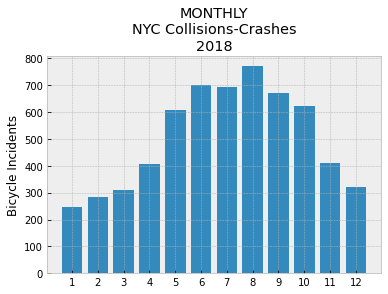

In [ ]:
#@title
vzb18mc = vzb2018i['Crash Date'].dt.month.value_counts().sort_index()
plt.bar(vzb18mc.index,vzb18mc.values)
plt.xticks(range(1,13))
plt.xlabel('')
plt.ylabel('Bicycle Incidents')
plt.title('MONTHLY\nNYC Collisions-Crashes\n2018')
plt.show()
#2018 Higher crashes during the warmer months..increased usage of bikes. august is a large touristic(additional drivers, additional bike share users) month. 

2018 Higher crashes during the warmer months..increased usage of bikes. august is a large touristic(additional drivers, additional bike share users) month. 

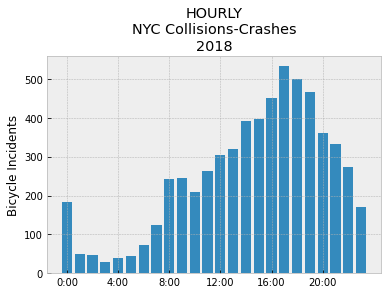

In [ ]:
#@title
vzb18ctc = vzb2018i['Crash Time'].str.split(':').str[0].astype('int').value_counts().sort_index()
plt.bar(vzb18ctc.index,vzb18ctc.values)
plt.xticks(range(0,24,4),[str(x)+":00" for x in range(0,24,4)])
plt.xlabel('')
plt.ylabel('Bicycle Incidents')
plt.title('HOURLY\nNYC Collisions-Crashes\n2018')
plt.show()

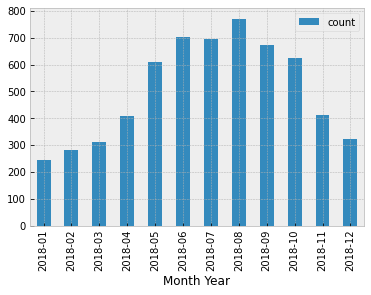

In [ ]:
#@title
# create a representation of the month with strfmt
vzb2018i['Month Year'] = vzb2018i['Crash Date'].map(lambda dt: dt.strftime('%Y-%m'))
grouped_vzb2018i = vzb2018i.groupby('Month Year').size().to_frame("count").reset_index()
grouped_vzb2018i.plot(kind='bar', x='Month Year', y='count')
#sns.lmplot(data=vzb2018i, x='Collision ID', y='Crash Time', col='Person Injury', hue='Gender')

In [ ]:
#@title


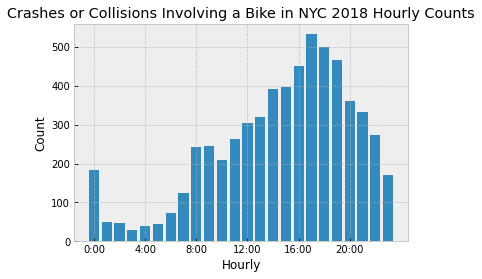

In [ ]:
#@title
vzbctc = vzb2018i['Crash Time'].str.split(':').str[0].astype('int').value_counts().sort_index()
plt.bar(vzbctc.index,vzbctc.values)
plt.xticks(range(0,24,4),[str(x)+":00" for x in range(0,24,4)])
plt.xlabel('Hourly')
plt.ylabel('Count')
plt.title('Crashes or Collisions Involving a Bike in NYC 2018 Hourly Counts')
plt.show()

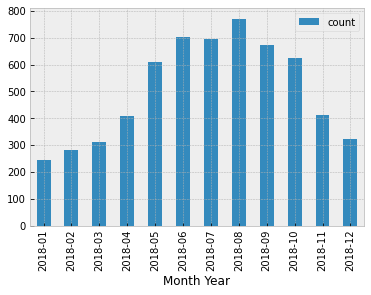

In [ ]:
#@title
# create a representation of the month with strfmt
vzb2018i['Month Year'] = vzb2018i['Crash Date'].map(lambda dt: dt.strftime('%Y-%m'))
grouped_vzb2018i = vzb2018i.groupby('Month Year').size().to_frame("count").reset_index()
grouped_vzb2018i.plot(kind='bar', x='Month Year', y='count')
#sns.lmplot(data=vzb2018i, x='Collision ID', y='Crash Time', col='Person Injury', hue='Gender')

In [ ]:
#@title
print(vzb2018i['Bodily Injury'].unique())

['Knee-Lower Leg Foot' 'Hip-Upper Leg' 'Does Not Apply' 'Back' 'Face'
 'Head' 'Entire Body' 'Elbow-Lower-Arm-Hand' 'Shoulder - Upper Arm'
 'Unknown' 'Neck' 'Abdomen - Pelvis' 'Chest' 'Eye']


In [ ]:
#@title
print('Bodily Injury: \n', vzb2018i['Bodily Injury'].value_counts())

Bodily Injury: 
 Knee-Lower Leg Foot     1471
Does Not Apply          1318
Elbow-Lower-Arm-Hand     702
Head                     679
Shoulder - Upper Arm     461
Back                     310
Entire Body              290
Hip-Upper Leg            262
Face                     234
Neck                     146
Abdomen - Pelvis          75
Chest                     62
Unknown                   37
Eye                        5
Name: Bodily Injury, dtype: int64


In [ ]:
#@title
print('Bicyclists involved Gender count:\n',vzb2018i['Gender'].value_counts())

Bicyclists involved Gender count:
 M    5330
F     708
U      14
Name: Gender, dtype: int64


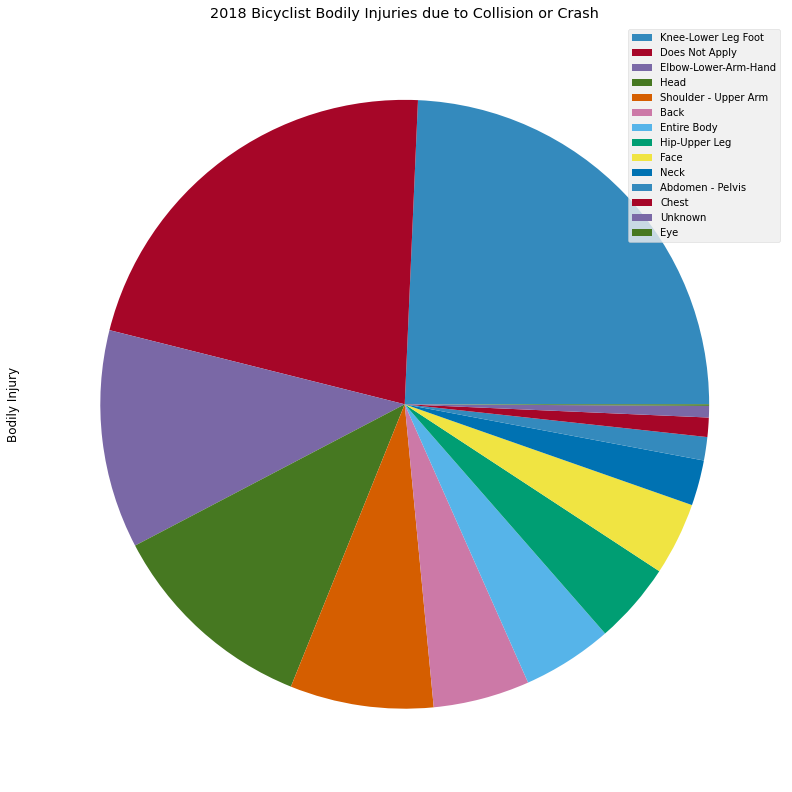

In [ ]:
#@title
vzb2018i['Bodily Injury'].value_counts().plot.pie(figsize=(14,14), labeldistance=None, legend=True, title='2018 Bicyclist Bodily Injuries due to Collision or Crash')
#

### "Bicyclists Bodily Injuries\nNYC Collisions-Crashes\n2018"


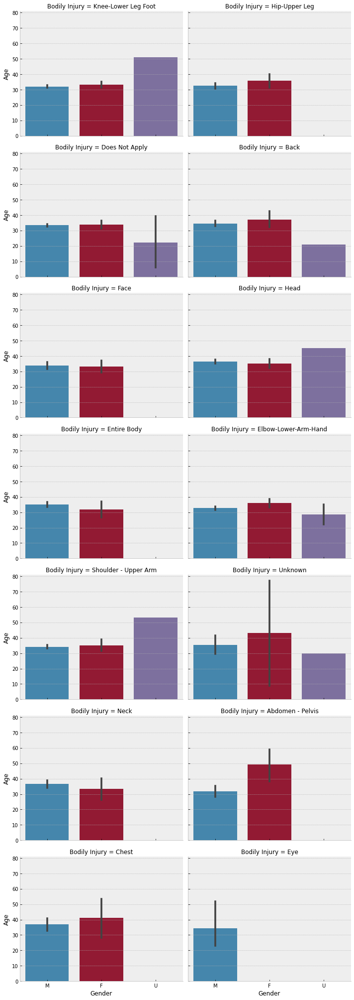

In [ ]:
#@title
vzvb = sns.FacetGrid(data=vzb2018i, col='Bodily Injury', hue='Gender', height=4, aspect=1.25, col_wrap=2)
vzvb.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")

In [ ]:
#@title
#plt.figure(figsize=(28, 5))
#sns.barplot(data=vzb2018i, x='Bodily Injury', y='Age', hue='Gender', order = ['Unknown', 'Head', 'Neck', 'Shoulder-Upper Arm', 'Face', 'Eye', 'Elbow-Lower Arm-Hand', 'Chest', 'Abdomen-Pelvis', 'Entire Body', 'Knee-Lower Leg Foot', 'Back', 'Hip-Upper Leg', 'Does Not Apply'])
#plt.title("Bicyclists Bodily InjuriesY\nNYC Collisions-Crashes\n2018")
#plt.show()

### "Bicyclists Emotional Status\nNYC Collisions-Crashes\n2018"

In [ ]:
#@title
print('Emotional Status: \n', vzb2018i['Emotional Status'].value_counts())

Emotional Status: 
 Conscious         4462
Does Not Apply    1321
Shock               90
Unknown             63
Semiconscious       57
Unconscious         31
Incoherent          23
Apparent Death       5
Name: Emotional Status, dtype: int64


In [ ]:
#@title
vzb2018i['Emotional Status'].value_counts().plot.pie(figsize=(14,14), legend=True, labeldistance=None, title='2018 Bicyclist Emotional Status at Time of Collision or Crash')

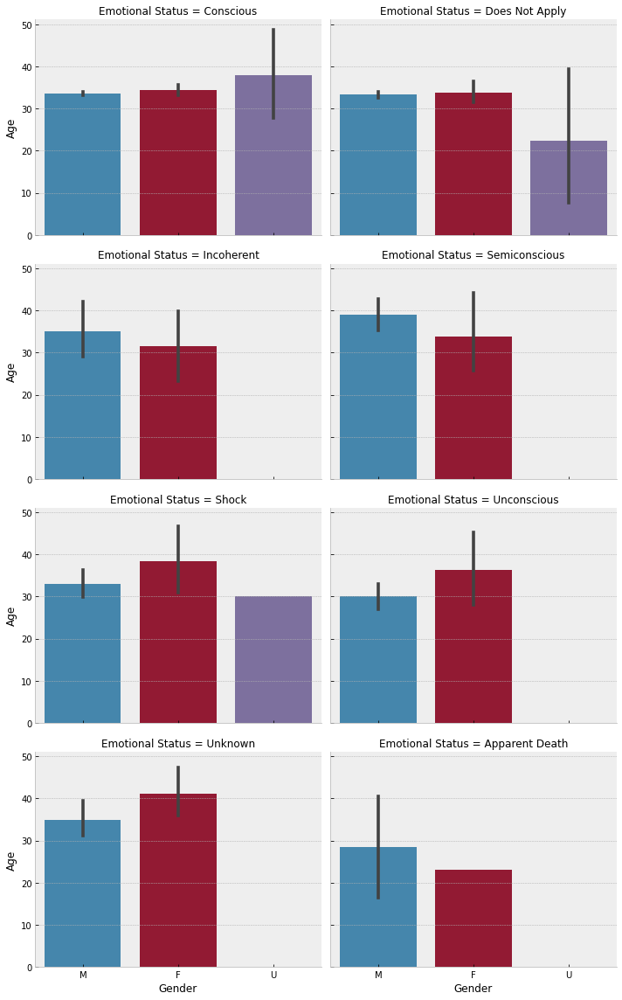

In [ ]:
#@title
vzvb = sns.FacetGrid(data=vzb2018i, col='Emotional Status', hue='Gender', height=4, aspect=1.25, col_wrap=2)
vzvb.map(sns.barplot, 'Gender', 'Age', order=['M', 'F', 'U'])

In [ ]:
#@title
#plt.figure(figsize=(31, 5))
#sns.barplot(data=vzb2018i, x='Emotional Status', y='Age', hue='Gender', order = ['Unknown','Conscious', 'Semiconscious', 'Unconscious', 'Shock', 'Incoherent', 'Apparent Death', 'Does Not Apply'], palette = "muted" )
#plt.title("2018 Emotional Status of Bicyclist in a crash or colission")
#plt.show()
#Unknown seem to be soley conciou

In [ ]:
#@title
#sns.pairplot(data=vzb2018i, hue='Emotional Status',  palette='Spectral_r') 

In [ ]:
#@title
print('Person Injury: \n', vzb2018i['Person Injury'].value_counts())

Person Injury: 
 Injured        4724
Unspecified    1318
Killed           10
Name: Person Injury, dtype: int64


In [ ]:
#@title
vzb2018i['Person Injury'].value_counts().sum()

6052

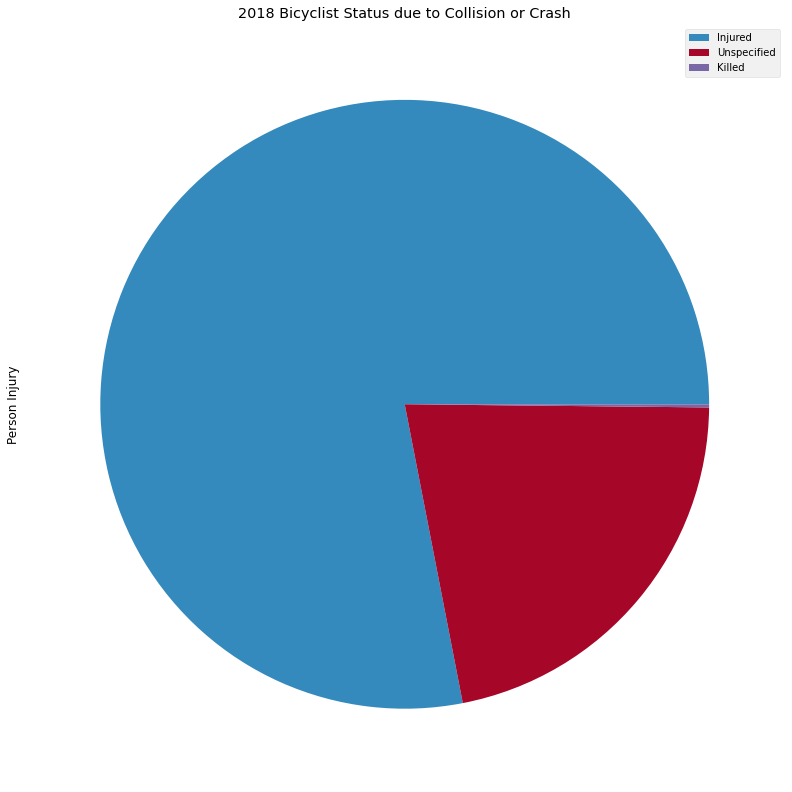

In [ ]:
#@title
vzb2018i['Person Injury'].value_counts().plot.pie(figsize=(14,14), legend=True, labeldistance=None,  title='2018 Bicyclist Status due to Collision or Crash')

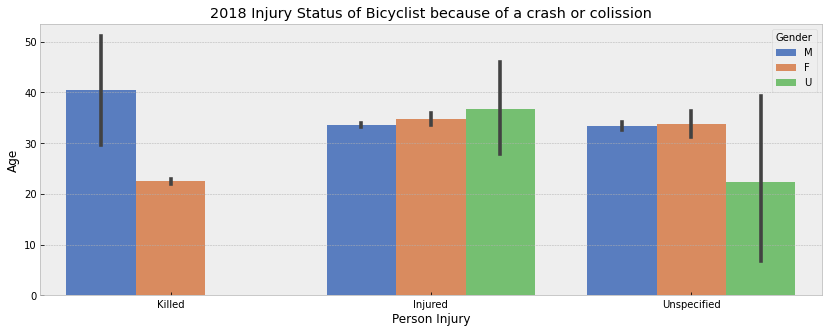

In [ ]:
#@title
plt.figure(figsize=(14, 5))
sns.barplot(data=vzb2018i, x='Person Injury', y='Age', hue='Gender', order = ['Killed', 'Injured', 'Unspecified'], palette = "muted" )
plt.title("2018 Injury Status of Bicyclist because of a crash or colission")
plt.show()
#U

In [ ]:
#@title
print(vzb2018i ['Safety Equipment'].unique())

['None' 'Stoppers Only (In-Line Skater/Bicyclist)'
 'Helmet Only (In-Line Skater/Bicyclist)' 'Unknown'
 'Helmet/Other (In-Line Skater/Bicyclist)' 'Helmet (Motorcycle Only)'
 'Other' 'Lap Belt' 'Lap Belt & Harness' 'Air Bag Deployed/Lap Belt'
 'Pads Only (In-Line Skater/Bicyclist)' 'Harness' 'Child Restraint Only']


In [ ]:
#@title
#Total counts of Persons Injured
print('Person Injury: \n', vzb2018i ['Person Injury'].value_counts())

Person Injury: 
 Injured        4724
Unspecified    1318
Killed           10
Name: Person Injury, dtype: int64


In [ ]:
#@title
#Total counts by Gender of Persons Injured
print('Person Injury: \n', vzb2018i ['Gender'].value_counts())

Person Injury: 
 M    5330
F     708
U      14
Name: Gender, dtype: int64


In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Gender', grid_kind='kde', grid_kws={'alpha':.5}) 

In [ ]:
#@title
vzb2018i.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
#sns.plot(data=vzb2018i.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Person Injury', height=2.5) 

In [ ]:
#@title
vzb2018i.groupby(['Gender','Bodily Injury'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Bodily Injury') 

In [ ]:
#@title
vzb2018i.groupby(['Gender','Person Role'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Person Role') 

In [ ]:
#@title
vzb2018i.groupby(['Gender','Emotional Status'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Emotional Status') 

In [ ]:
#@title
print('Bodily Injury: \n', vzb2018i['Bodily Injury'].value_counts())

In [ ]:
#@title
print('Bicyclists involved Gender count:\n',vzb2018i['Gender'].value_counts())

In [ ]:
#@title
vzb2018i['Bodily Injury'].value_counts().plot.pie(figsize=(14,14), legend=True, labeldistance=None, title='2018 Bicyclist Bodily Injuries due to Collision or Crash')

In [ ]:
#@title
plt.figure(figsize=(34, 5))
sns.barplot(data=vzb2018i, x='Bodily Injury', y='Age', hue='Gender', order = ['Unknown', 'Head', 'Neck', 'Shoulder-Upper Arm', 'Face', 'Eye', 'Elbow-Lower Arm-Hand', 'Chest', 'Abdomen-Pelvis', 'Entire Body', 'Knee-Lower Leg Foot', 'Back', 'Hip-Upper Leg', 'Does Not Apply'], palette = "muted" )
plt.title("2018 Bodily Injuries of Bicyclist in a crash or colission")
plt.show()

In [ ]:
#@title
print('Emotional Status: \n', vzb2018i['Emotional Status'].value_counts())

In [ ]:
#@title
vzb2018i['Emotional Status'].value_counts().plot.pie(figsize=(14,14), legend=True, labeldistance=None,  title='2018 Bicyclist Emotional Status at Time of Collision or Crash')

In [ ]:
#@title
plt.figure(figsize=(24, 5))
sns.barplot(data=vzb2018i, x='Emotional Status', y='Age', hue='Gender', order = ['Unknown','Conscious', 'Semiconscious', 'Unconscious', 'Shock', 'Incoherent', 'Apparent Death', 'Does Not Apply'], palette = "muted" )
plt.title("2018 Emotional Status of Bicyclist in a crash or colission")
plt.show()
#Unknown seem to be soley conciou

In [ ]:
#@title
#sns.pairplot(data=vzb2018i, hue='Emotional Status',  palette='Spectral_r') 

In [ ]:
#@title
print('Person Injury: \n', vzb2018i['Person Injury'].value_counts())

In [ ]:
#@title
vzb2018i['Person Injury'].value_counts().sum()

In [ ]:
#@title
vzb2018i['Person Injury'].value_counts().plot.pie(figsize=(14,14), legend=True, labeldistance=None,  title='2018 Bicyclist Status due to Collision or Crash')

In [ ]:
#@title
plt.figure(figsize=(14, 5))
sns.barplot(data=vzb2018i, x='Person Injury', y='Age', hue='Gender', order = ['Killed', 'Injured', 'Unspecified'], palette = "muted" )
plt.title("2018 Injury Status of Bicyclist because of a crash or colission")
plt.show()
#U

In [ ]:
#@title
sns.stepplot(x='Safety Equipment', y='Bodily Injury', hue='Gender',alpha=.5, size=1, data=vzb2018i)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Gender' ) 

In [ ]:
#@title
vzb2018i.groupby(['Gender','Person Injury'])['Age'].mean().sort_values(ascending=True)

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Person Injury', height=2.5) 

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Bodily Injury') 

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Person Role') 

In [ ]:
#@title
sns.pairplot(data=vzb2018i, hue='Emotional Status') 